In [1]:
from scipy.signal import convolve2d
import numpy as np
import skimage as sk
import skimage.io as skio
import matplotlib.pyplot as plt
import pickle
import os

# Part 1: Fun with Filters

## Part 1.1: Finite Difference Operator

In [2]:
def rescale(img: np.ndarray) -> np.ndarray:
    """Linearly rescales an img between its minimum and maximum values. For display purposes"""
    maximum = np.max(img)
    minimum = np.min(img)

    return (img - minimum) / (maximum - minimum)

def show(img: np.ndarray | list[np.ndarray], should_rescale: bool=True, should_clip: bool = True, out_file: str | None = "") -> None:
    """Displays an image. If a list of images is passed in, displays all images side-by-side horizontally.
    If should_rescale is set to True, linearly rescales each of the passed-in images. """
    if not isinstance(img, list):
        img = [img]
    result = []
    for i in img:
        i = sk.img_as_float(i)
        if should_rescale:
            i = rescale(i)
        if should_clip:
            i = np.clip(i, 0, 1)
        result.append(i)
    max_width = max([r.shape[0] for r in result])
    max_height = max([r.shape[1] for r in result])

    def pad_with_black(i):
        """Pads the image with black to get the image to max_width by max_height"""
        if len(i.shape) == 3:
            return np.pad(i, [(0, max_width - i.shape[0]), (0, max_height - i.shape[1]), (0, 0)])
        else:
            return np.pad(i, [(0, max_width - i.shape[0]), (0, max_height - i.shape[1])])


    result = [pad_with_black(r) for r in result]
    result = np.hstack(result)
    result = sk.img_as_ubyte(result)
    skio.imshow(result)
    skio.show()

    if out_file:
        fname = f'./out/{os.path.split(out_file)[1]}'
        skio.imsave(fname, result)


def read_image(file: str) -> np.ndarray:
    """Reads an image as either a 2-channel grayscale image 
    or a 3-channel RGB image and in float mode."""
    image = skio.imread(file)
    image = sk.img_as_float(image)
    assert len(image.shape) == 2 or len(image.shape) == 3
    if len(image.shape) == 3 and image.shape[2] == 4:
        image = sk.color.rgba2rgb(image)
    return image


In [3]:
# define finite difference operators in both directions
D_x: np.ndarray = np.array([[1, -1]])
D_y: np.ndarray = np.array([[1], [-1]])

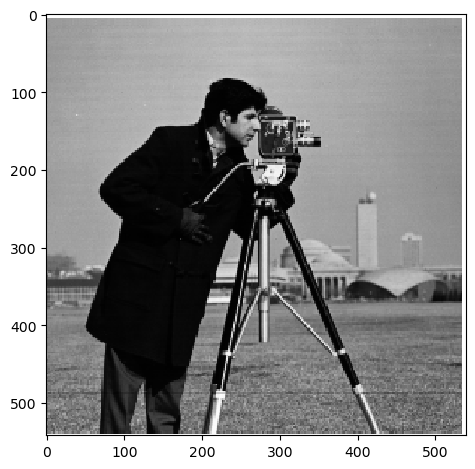

In [4]:
# read cameraman image and transform to 3-channel (rgb) float
cameraman = read_image("./cameraman.png")
show(cameraman)

In [5]:
def convolve_3d(img, conv_filter, mode="same"):
    """Convolves 3-dimensional `img` with `conv_filter` using the specified mode. Assumes `img` contains channels (i.e., the 3rd dimension) but `conv_filter` should not. """
    assert len(img.shape) == 3
    assert len(conv_filter.shape) == 2
    convolutions = []

    # convolve the filter with each channel independently
    for channel_idx in range(img.shape[2]):
        channel = img[:, :, channel_idx]
        channel_convolved = convolve2d(channel, conv_filter, mode=mode, boundary="symm")
        convolutions.append(channel_convolved)

    # combine the channel convolutions together for the final result
    return np.dstack(convolutions)


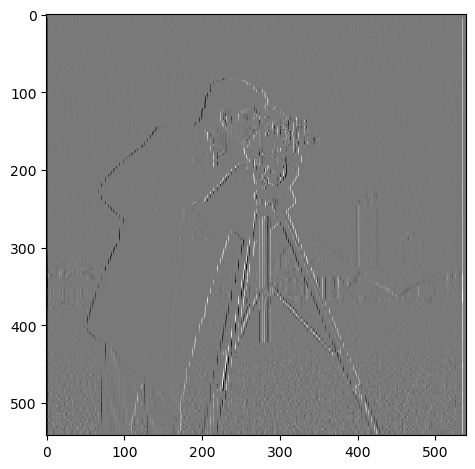

In [6]:
# partial derivative in x of the cameraman image (detects vertical edges)
D_x_convolved = convolve_3d(cameraman, D_x)
show(D_x_convolved, out_file="cameraman_dx.jpg")

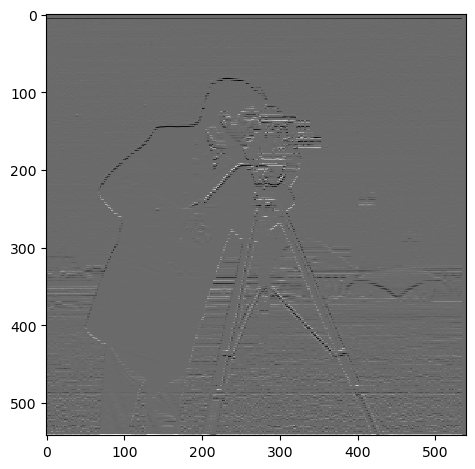

In [7]:
# partial derivative in y of the cameraman image (detects horizontal edges)
D_y_convolved = convolve_3d(cameraman, D_y)
show(D_y_convolved, out_file="cameraman_dy.jpg")

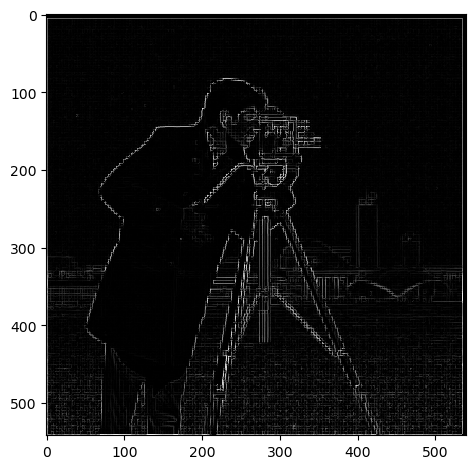

In [8]:
# compute the gradient magnitude images with the partial derivatives in x and y
gradient_magnitude = np.sqrt(D_x_convolved ** 2 + D_y_convolved ** 2)
show(gradient_magnitude, out_file="gradient_magnitude.jpg")

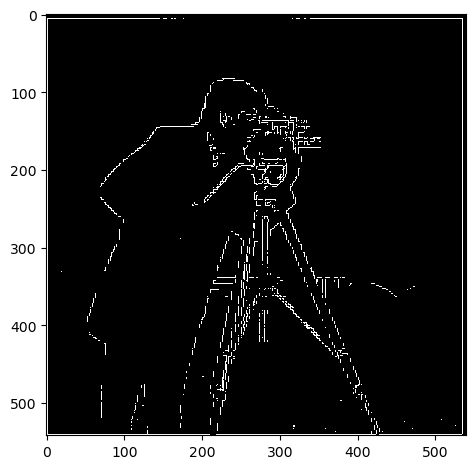

In [9]:
# binarize the gradient magnitude with a user-specified threshold
threshold = 0.3
binarize_gradient_magnitude = np.where(gradient_magnitude < threshold, 0, 1)
show(binarize_gradient_magnitude, out_file="binarized_gradient_magnitude.jpg")

## Part 1.2: Derivative of Gaussian Filter

In [10]:
from cv2 import getGaussianKernel

In [11]:
def get_gaussian(sigma: int | float, ksize: int | None = None) -> np.ndarray:
    """Returns a Gaussian filter with the specified standard deviation (sigma).
    If ksize is not specified, defaults to a ksize around 6 * standard deviation.
    Additionally ensures ksize is odd"""
    # default behavior is ~6 * sigma
    if not ksize:
        ksize = int(6 * sigma - 1)

    # ensure ksize is odd
    if ksize % 2 == 0:
        ksize += 1

    # 2d gaussian is the outer product of 1d gaussian with itself
    gaussian_1d = getGaussianKernel(ksize, sigma)
    gaussian = gaussian_1d @ gaussian_1d.T
    return gaussian


def blur(img, gaussian):
    """Blurs `img` by convolving with the provided `gaussian`"""
    return convolve_3d(img, gaussian)

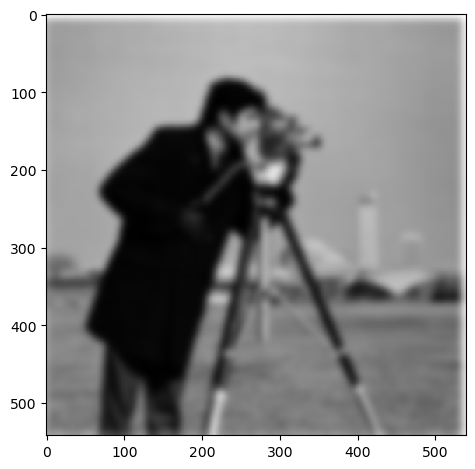

In [12]:
# blur cameraman by convolving with Gaussian
cameraman_gaussian = get_gaussian(sigma=5)
blurred_cameraman = blur(cameraman, cameraman_gaussian)
show(blurred_cameraman, out_file="blurred_cameraman.jpg")

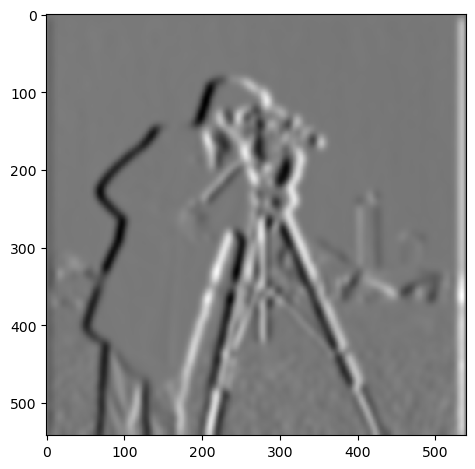

In [13]:
# compute partial derivative in x of blurred cameraman to detect vertical edges
D_x_blurred_cameraman = convolve_3d(blurred_cameraman, D_x)
show(D_x_blurred_cameraman, out_file="dx_blurred_cameraman.jpg")

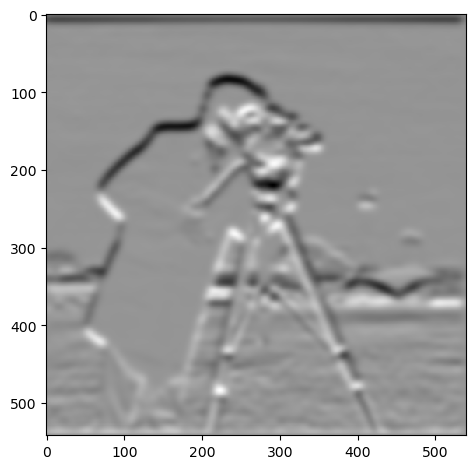

In [14]:
# compute partial derivative in y of blurred cameraman to detect horizontal edges
D_y_blurred_cameraman = convolve_3d(blurred_cameraman, D_y)
show(D_y_blurred_cameraman, out_file="dy_blurred_cameraman.jpg")

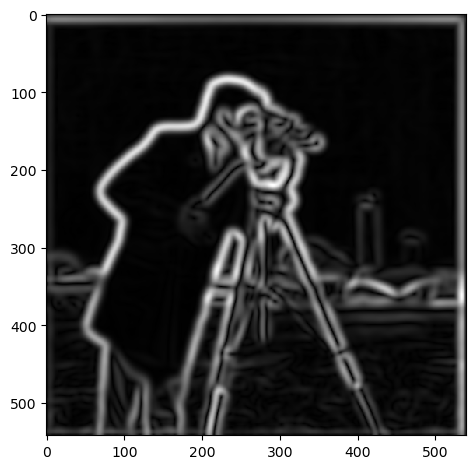

In [15]:
# compute the gradient magnitude of the blurred cameraman 
gradient_magnitude_blurred_cameraman = np.sqrt(D_x_blurred_cameraman ** 2 + D_y_blurred_cameraman ** 2)
show(gradient_magnitude_blurred_cameraman, out_file="gradient_blurred_cameraman.jpg")

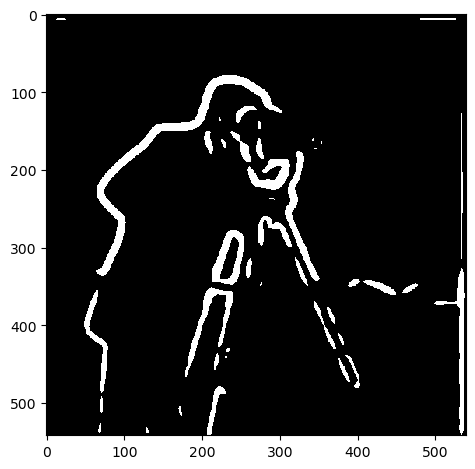

In [16]:
# binarize the gradient magnitude of the blurred image with a user-specified threshold
threshold = 0.03
binarize_gradient_magnitude_blurred_cameraman = np.where(gradient_magnitude_blurred_cameraman < threshold, 0, 1)
show(binarize_gradient_magnitude_blurred_cameraman, out_file="binary_gradient_blurred_cameraman.jpg")

In [17]:
# create derivative of gaussian filters in both x and y directions
D_x_gaussian = convolve2d(D_x, cameraman_gaussian)
D_y_gaussian = convolve2d(D_y, cameraman_gaussian)

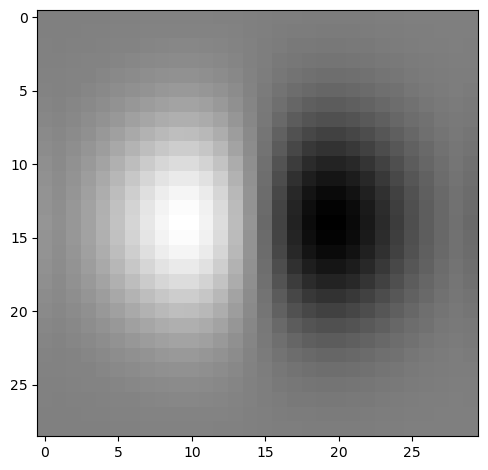

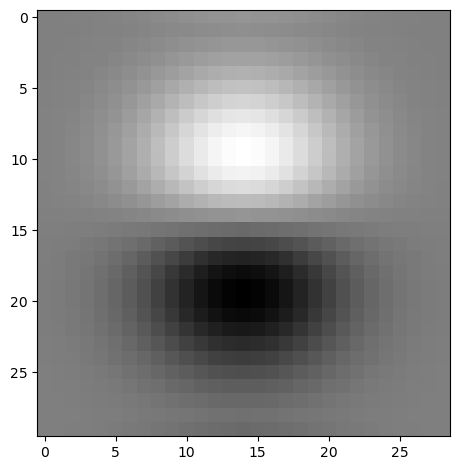

In [24]:
show(D_x_gaussian, out_file="dog_x.jpg")
show(D_y_gaussian, out_file="dog_y.jpg")

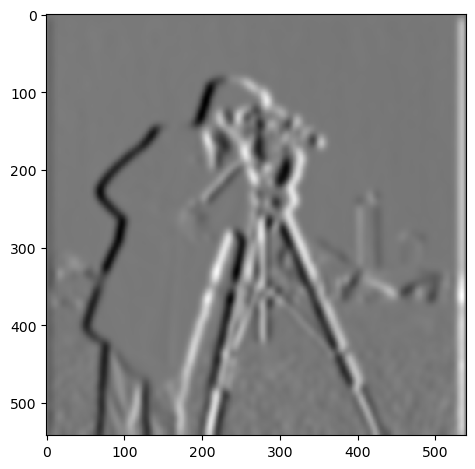

In [19]:
# get derivative of gaussian in x direction
D_x_gaussian_convolved = convolve_3d(cameraman, D_x_gaussian)
show(D_x_gaussian_convolved, out_file="dog_x_cameraman.jpg")

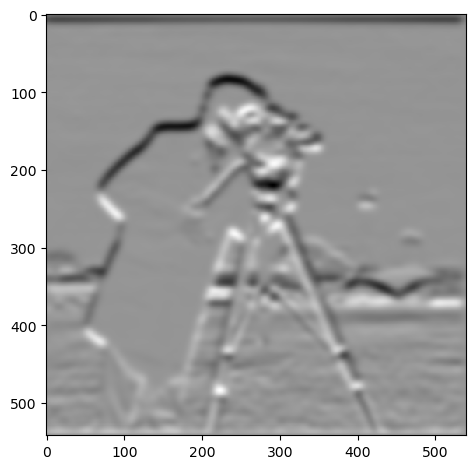

In [20]:
# get derivative of gaussian in y direction
D_y_gaussian_convolved = convolve_3d(cameraman, D_y_gaussian)
show(D_y_gaussian_convolved, out_file="dog_y_cameraman.jpg")

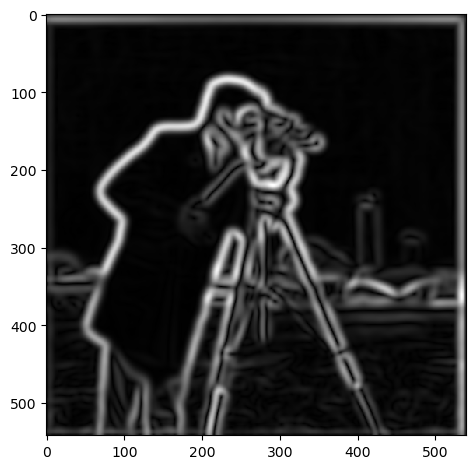

In [21]:
# get gradient magnitude of derivative of Gaussian
deriv_of_gaussian_gradient_magnitude = np.sqrt(D_x_gaussian_convolved ** 2 + D_y_gaussian_convolved ** 2)
show(deriv_of_gaussian_gradient_magnitude, out_file="dog_gradient_magnitude_cameraman.jpg")

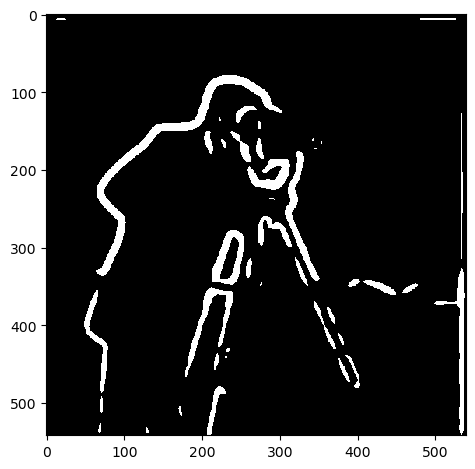

In [22]:
# binarize the derivative of Gaussian gradient magnitude with a user-specified threshold
threshold = 0.03
binarize_deriv_of_gaussian_gradient_magnitude = np.where(deriv_of_gaussian_gradient_magnitude < threshold, 0, 1)
show(binarize_deriv_of_gaussian_gradient_magnitude, out_file="dog_binary_gradient_magnitude_cameraman.jpg")

Yes, we see the same result whether we first convolve with the Gaussian and then the finite difference operators or whether we convolve the Gaussian and finite difference operator together to create a Derivative of Gaussian filter which we then apply. This makes sense due to the commutative/associative properties of convolution.

# Part 2: Fun with Frequencies!

## Part 2.1: Image "Sharpening"

In [28]:
taj_gaussian = get_gaussian(sigma=5, ksize=29)

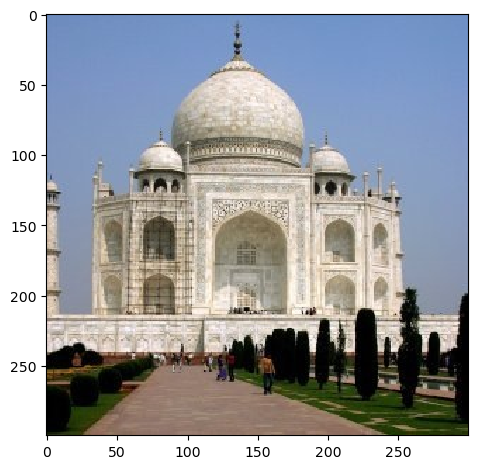

In [29]:
# read taj image
taj = read_image("taj.jpg")
show(taj)

### Sharpening by adding in high frequencies

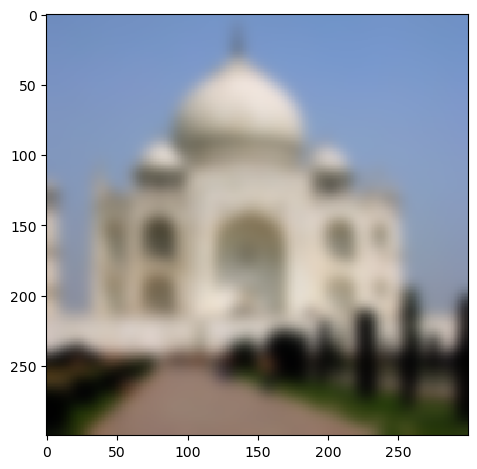

In [30]:
# blur the taj to get the low frequencies
blurred_taj = blur(taj, taj_gaussian)
show(blurred_taj, should_rescale=False, should_clip=True, out_file="taj_blur.jpg")

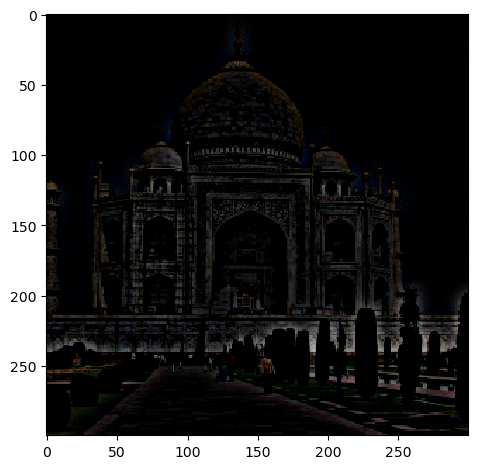

In [31]:
# subtract the low frequencies out to get the high frequencies
high_freqs_taj = taj - blurred_taj
show(high_freqs_taj, should_rescale=False, should_clip=True, out_file="taj_high_freqs.jpg")

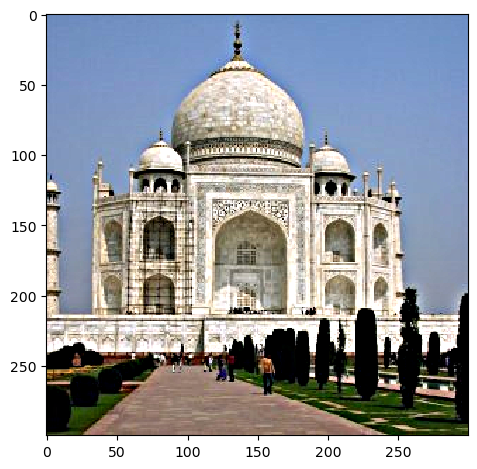

In [32]:
# sharpen the image by adding in the high frequencies
alpha = 1
sharpened_taj = taj + alpha * high_freqs_taj
show(sharpened_taj, should_rescale=False, should_clip=True, out_file="taj_sharpened.jpg") 

### Sharpening with the unsharp mask filter

In [34]:
def get_unit_impulse(shape: tuple) -> np.ndarray:
    """Gets a unit impulse according to a certain shape"""
    unit_impulse = np.zeros(shape)
    unit_impulse[(unit_impulse.shape[0] + 1) // 2, (unit_impulse.shape[1] + 1) // 2] = 1
    return unit_impulse

def get_unsharp_mask_filter(gaussian: np.ndarray, alpha: float = 1) -> np.ndarray:
    unit_impulse = get_unit_impulse(gaussian.shape)
    unsharp_mask_filter = (1 + alpha) * unit_impulse - alpha * gaussian
    return unsharp_mask_filter


def sharpen(img: np.ndarray, gaussian: np.ndarray, alpha: float=1) -> np.ndarray:
    """Sharpens an image by convolving with the unsharp mask filter"""
    unsharp_mask_filter = get_unsharp_mask_filter(gaussian, alpha)
    return convolve_3d(img, unsharp_mask_filter)
    

In [61]:
unsharp_mask_filter =  get_unsharp_mask_filter(taj_gaussian)

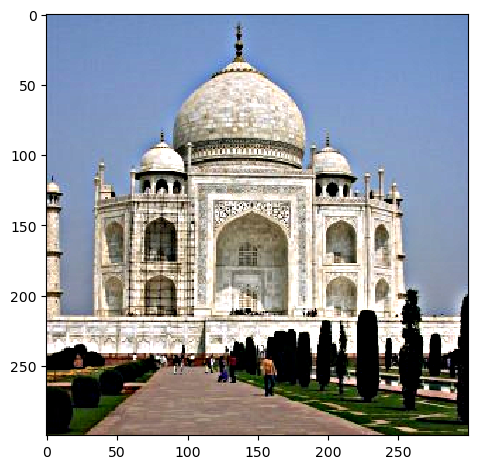

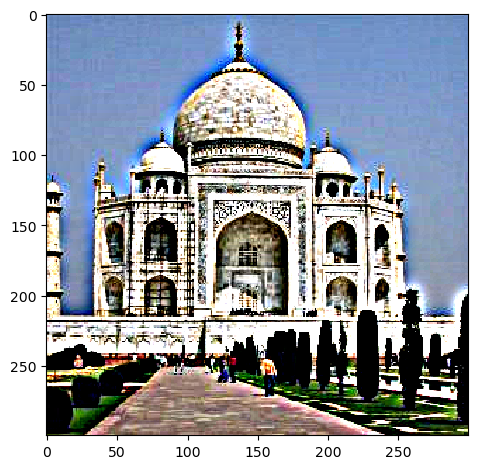

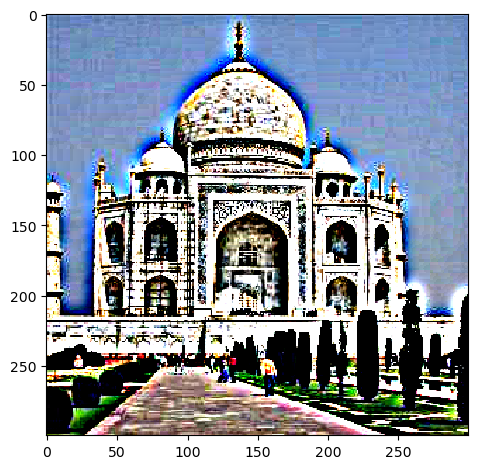

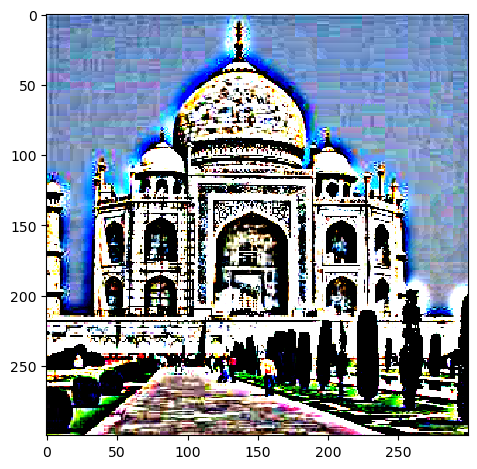

In [62]:
show(sharpen(taj, taj_gaussian, alpha=1), should_rescale=False, should_clip=True, out_file="taj_unsharp_mask_alpha1.jpg")
show(sharpen(taj, taj_gaussian, alpha=5), should_rescale=False, should_clip=True, out_file="taj_unsharp_mask_alpha5.jpg") #sharpening works
show(sharpen(taj, taj_gaussian, alpha=10), should_rescale=False, should_clip=True, out_file="taj_unsharp_mask_alpha10.jpg")
show(sharpen(taj, taj_gaussian, alpha=20), should_rescale=False, should_clip=True, out_file="taj_unsharp_mask_alpha20.jpg")

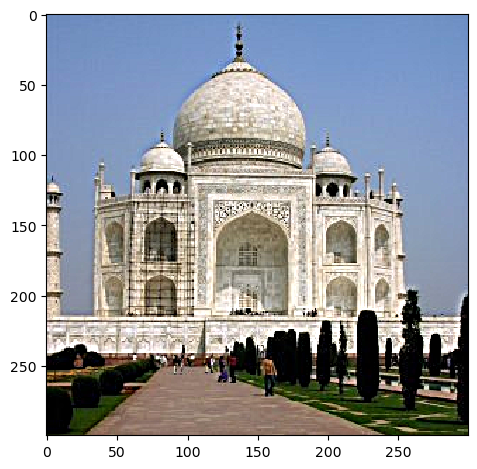

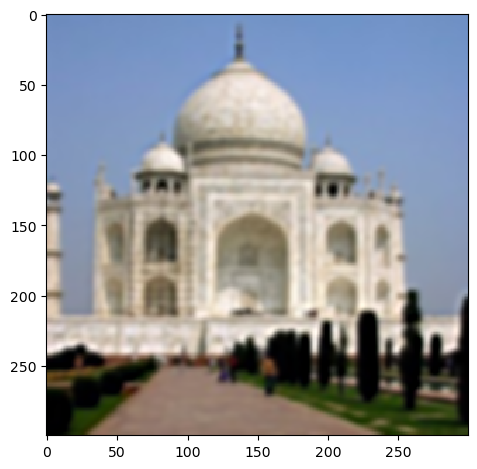

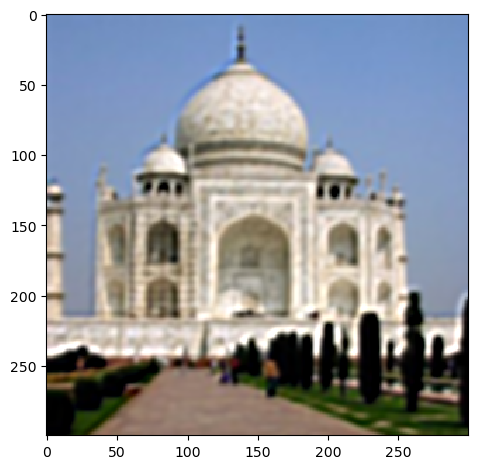

In [63]:
taj_gaussian_2 = get_gaussian(sigma=2)
sharp_taj = sharpen(taj, taj_gaussian_2)
show(sharp_taj, should_rescale=False, should_clip=True)

blur_sharp_taj = blur(sharp_taj, taj_gaussian_2)
show(blur_sharp_taj, should_rescale=False, should_clip=True)

alpha = 1
sharp_blur_sharp_taj = sharpen(blur_sharp_taj, taj_gaussian_2)
show(sharp_blur_sharp_taj, should_rescale=False, should_clip=True)

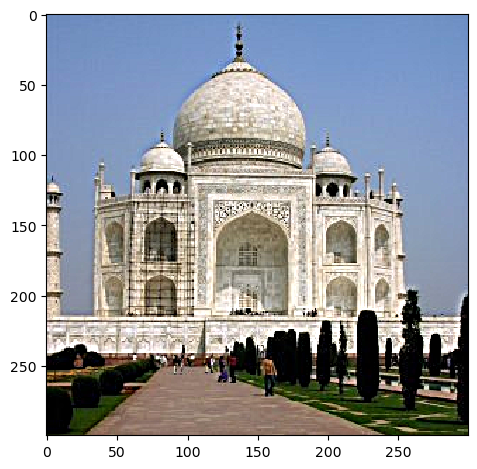

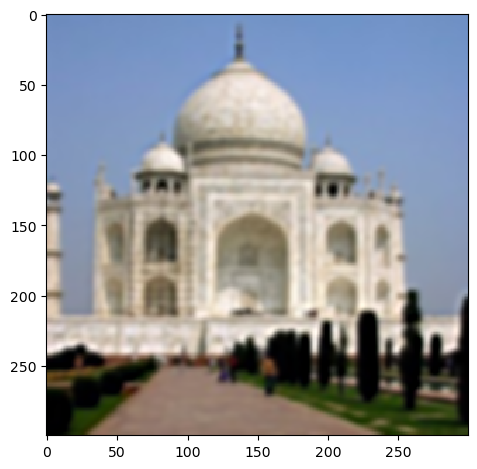

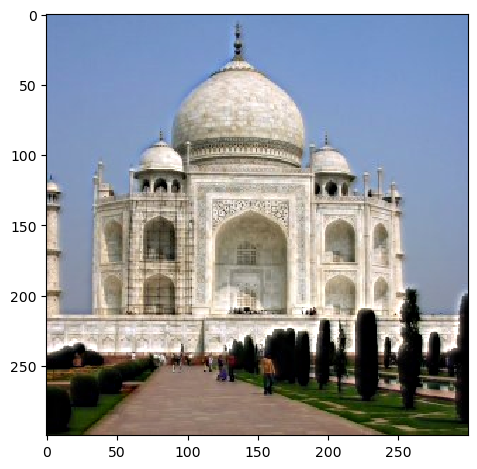

In [64]:
high_freqs_taj = taj - blur(taj, taj_gaussian_2)
sharp_taj = sharpen(taj, taj_gaussian_2)
show(sharp_taj, should_rescale=False, should_clip=True)

blur_sharp_taj = blur(sharp_taj, taj_gaussian_2)
show(blur_sharp_taj, should_rescale=False, should_clip=True)

alpha = 1
sharp_blur_sharp_taj = blur_sharp_taj + high_freqs_taj * alpha
show(sharp_blur_sharp_taj, should_rescale=False, should_clip=True)

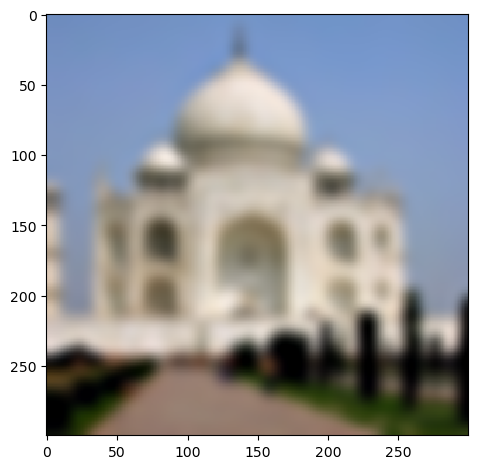

In [47]:
# blurs then sharpens
blur_then_sharp_taj = sharpen(blur(taj, taj_gaussian), taj_gaussian)
show(blur_then_sharp_taj, should_rescale=False, should_clip=True)

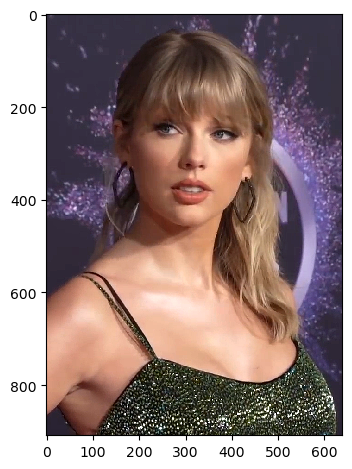

In [65]:
taylor_swift_1 = read_image("taylorswift1.png")
show(taylor_swift_1)


In [72]:
taylor_swift_1_gaussian = get_gaussian(sigma=5)

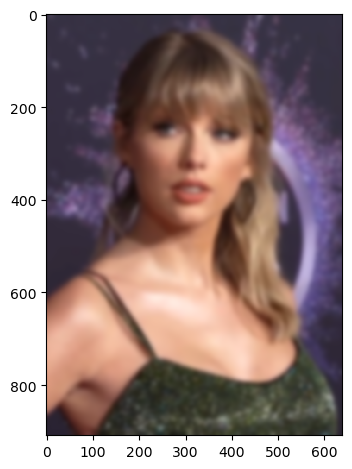

In [73]:

blur_ts = blur(taylor_swift_1, taylor_swift_1_gaussian)
show(blur_ts, should_rescale=False, should_clip=True, out_file="blur_ts.jpg")

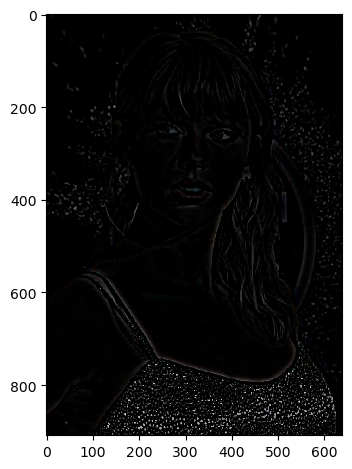

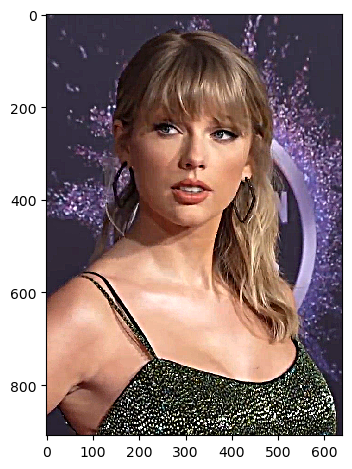

In [74]:
high_freqs_ts = taylor_swift_1 - blur_ts
show(high_freqs_ts, should_rescale=False, should_clip=True, out_file="high_freqs_ts.jpg")

alpha = 1
sharp_ts = taylor_swift_1 + high_freqs_ts * alpha
show(sharp_ts, should_rescale=False, should_clip=True, out_file="sharp_ts.jpg")

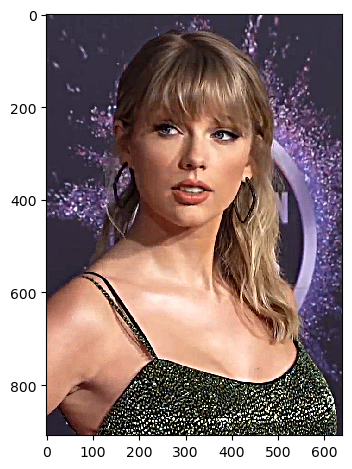

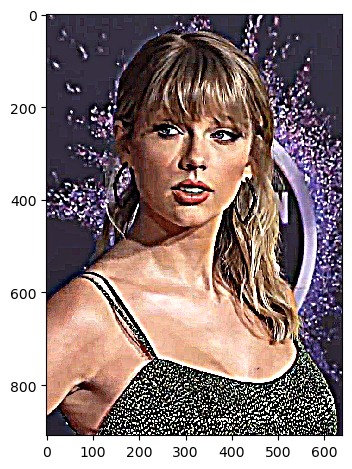

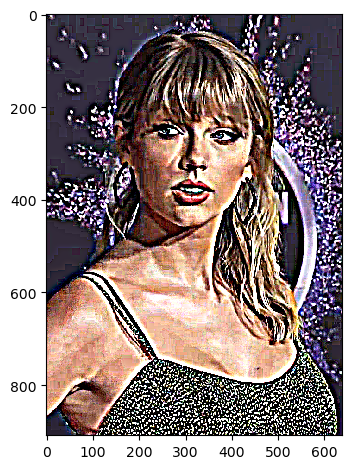

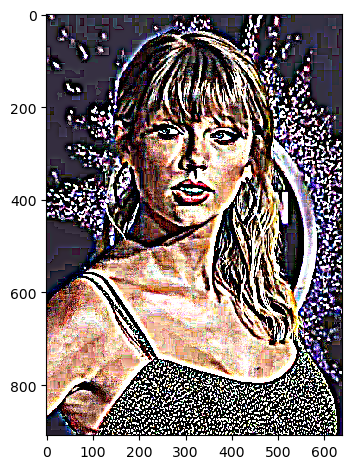

In [75]:

sharp_ts_1 = sharpen(taylor_swift_1, taylor_swift_1_gaussian, alpha=1)
show(sharp_ts_1, should_rescale=False, should_clip=True, out_file="sharp_ts_1.jpg")

sharp_ts_5 = sharpen(taylor_swift_1, taylor_swift_1_gaussian, alpha=5)
show(sharp_ts_5, should_rescale=False, should_clip=True, out_file="sharp_ts_5.jpg")

sharp_ts_10 = sharpen(taylor_swift_1, taylor_swift_1_gaussian, alpha=10)
show(sharp_ts_10, should_rescale=False, should_clip=True, out_file="sharp_ts_10.jpg")

sharp_ts_20 = sharpen(taylor_swift_1, taylor_swift_1_gaussian, alpha=20)
show(sharp_ts_20, should_rescale=False, should_clip=True, out_file="sharp_ts_20.jpg")



In [53]:

high_freqs_taylor_swift_1 = taylor_swift_1 - blur(taylor_swift_1, taylor_swift_1_gaussian)
sharp_taylor_swift_1 = sharpen(taylor_swift_1, taylor_swift_1_gaussian)
sharp_then_blur_then_sharp_taylor_swift_1 = blur(sharpen(taylor_swift_1, taylor_swift_1_gaussian)) + high_freqs_taylor_swift_1
show(sharp_taylor_swift_1)
show(sharp_then_blur_then_sharp_taylor_swift_1)

TypeError: blur() missing 1 required positional argument: 'gaussian'

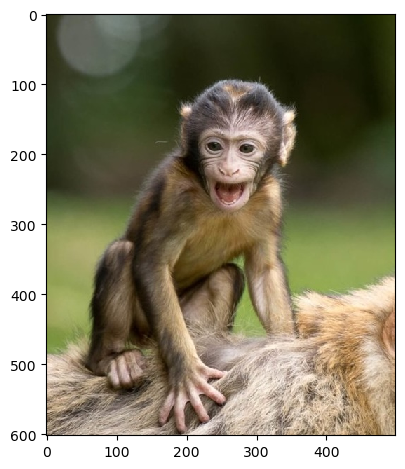

In [97]:
monkey_baby = read_image("monkeybaby.jpeg")
show(monkey_baby)

In [98]:
monkey_baby_gaussian = get_gaussian(sigma=5)

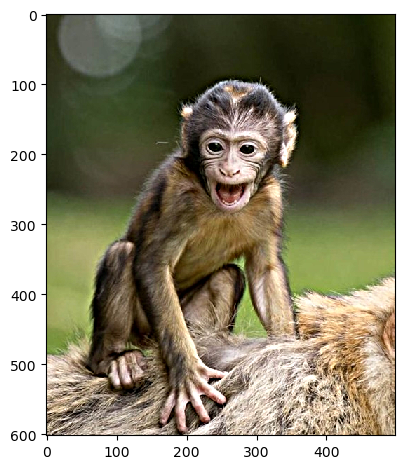

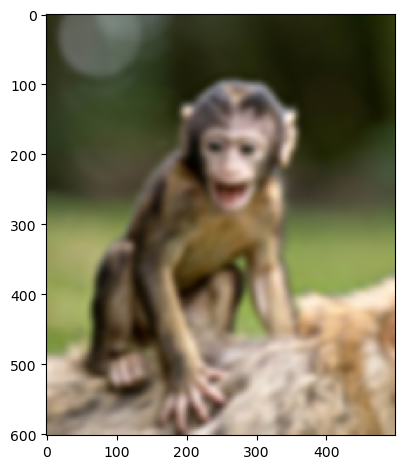

In [99]:
sharp_monkey_baby = sharpen(monkey_baby, monkey_baby_gaussian, alpha=1)
show(sharp_monkey_baby, should_rescale=False, should_clip=True, out_file="sharp_mb_1.jpg")

blurred_sharp_monkey_baby = blur(sharp_monkey_baby, monkey_baby_gaussian)
show(blurred_sharp_monkey_baby, should_rescale=False, should_clip=True, out_file="sharp_blur_mb_1.jpg")

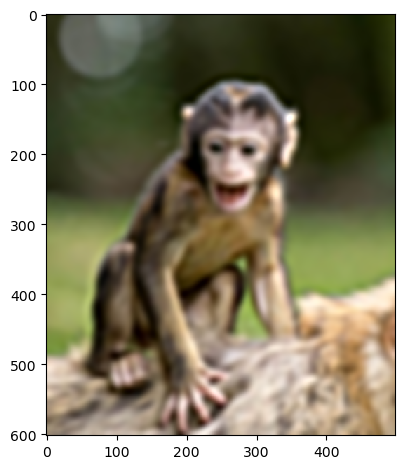

In [100]:
sharpened_blurred_sharp_monkey_baby = sharpen(blurred_sharp_monkey_baby, monkey_baby_gaussian, alpha=1)
show(sharpened_blurred_sharp_monkey_baby, should_rescale=False, should_clip=True, out_file="sharp_blur_sharp_mb_1.jpg")

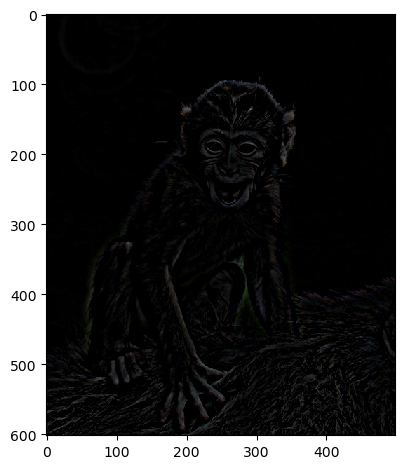

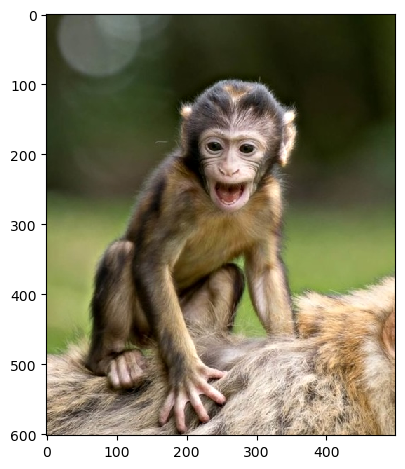

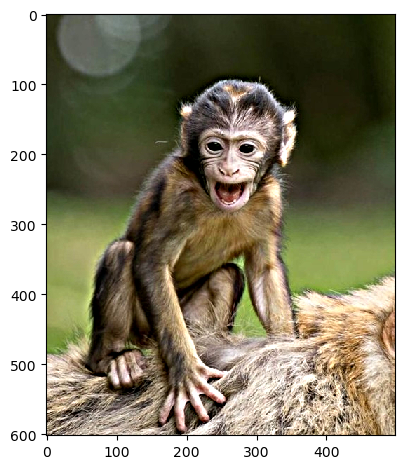

In [101]:
high_freqs_monkey_baby = monkey_baby - blur(monkey_baby, monkey_baby_gaussian)
show(high_freqs_monkey_baby, should_rescale=False, should_clip=True, out_file="high_freqs_mb_2.jpg")

alpha = 1
sharpened_blurred_sharp_monkey_baby = blurred_sharp_monkey_baby + alpha * high_freqs_monkey_baby
show(sharpened_blurred_sharp_monkey_baby, should_rescale=False, should_clip=True, out_file="sharp_blur_sharp_mb_2.jpg")

alpha = 2
sharpened_blurred_sharp_monkey_baby = blurred_sharp_monkey_baby + 2 * high_freqs_monkey_baby
show(sharpened_blurred_sharp_monkey_baby, should_rescale=False, should_clip=True, out_file="sharp_blur_sharp_mb_2_alpha2.jpg")

## Part 2.2: Hybrid images

In [50]:
def low_pass(img, sigma=5, ksize=None):
    """Low pass filter using Gaussian"""
    gaussian = get_gaussian(sigma, ksize)
    return convolve_3d(img, gaussian)

def high_pass(img, sigma=5, ksize=None):
    """High pass filter using impulse - Gaussian"""
    gaussian = get_gaussian(sigma, ksize)
    impulse = get_unit_impulse(gaussian.shape)
    return convolve_3d(img, impulse - gaussian)

def low_pass_and_high_pass(im1, im2, sigma1, sigma2, ksize1=None, ksize2=None):
    """Applies lowpass filter to image 1 and high pass filter to image 2"""
    lowpass_im1 = low_pass(im1, sigma1, ksize1)
    highpass_im2 = high_pass(im2, sigma2, ksize2)
    return lowpass_im1, highpass_im2

def hybrid_image(lowpass_im1, highpass_im2, color1=True, color2=True):
    """Creates hybrid image from lowpass filter applied to image 1 and highpass filter applied to image2.
    Can set each image to either color or greyscale"""
    if not color1:
        lowpass_im1_grayscale = rgb2gray(lowpass_im1)
        lowpass_im1 = np.dstack([lowpass_im1_grayscale, lowpass_im1_grayscale, lowpass_im1_grayscale])        
    
    if not color2:
        highpass_im2_grayscale = rgb2gray(highpass_im2)
        highpass_im2 = np.dstack([highpass_im2_grayscale, highpass_im2_grayscale, highpass_im2_grayscale])
    
    return lowpass_im1 + highpass_im2

# # Source: Von's discussion
def rgb2gray(rgb):
    # Based on luminance perception of human vision. This is usually what is going on under the hood.
    return rgb.dot([0.2989, 0.5870, 0.1140])
    # return rgb.dot([1/3, 1/3, 1/3])

def show_fourier(img, out_file=None):
    assert len(img.shape) == 3
    if img.shape[2] == 3:
        img = rgb2gray(img)
    result = np.log(np.abs(np.fft.fftshift(np.fft.fft2(img))))
    skio.imshow(result)
    skio.show()
    if out_file:
        fname = f'./out/{os.path.split(out_file)[1]}'
        skio.imsave(out_file, result)

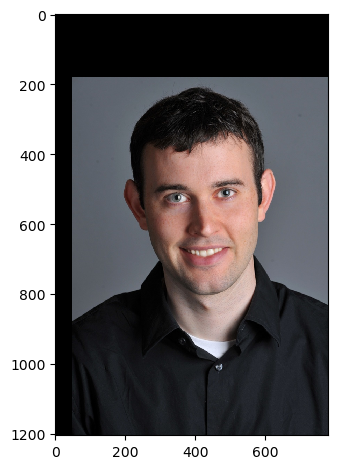

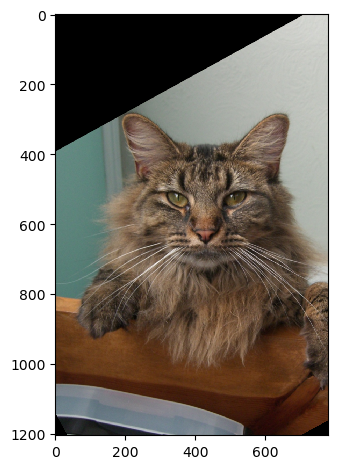

In [92]:
with open("derek_aligned", 'rb') as f:
    derek_aligned = pickle.load(f)
    
with open("nutmeg_aligned", 'rb') as f:
    nutmeg_aligned = pickle.load(f)

show(derek_aligned)
show(nutmeg_aligned)

In [139]:
sigma1 = 10
sigma2 = 7

lowpass_derek, highpass_nutmeg = low_pass_and_high_pass(derek_aligned, nutmeg_aligned, sigma1, sigma2)

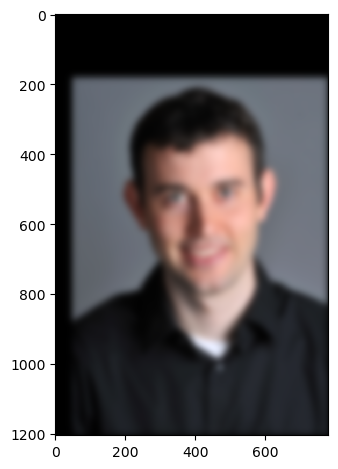

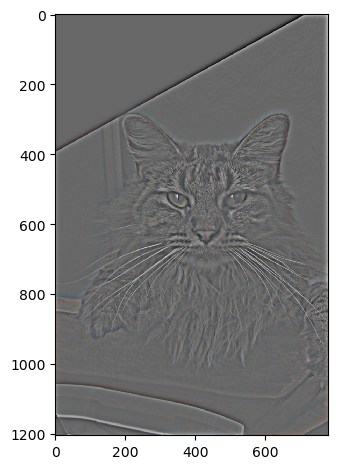

In [140]:
show(lowpass_derek)
show(highpass_nutmeg)

In [39]:


show_fourier(derek_aligned)
show_fourier(lowpass_derek)
show_fourier(nutmeg_aligned)
show_fourier(highpass_nutmeg)

NameError: name 'derek_aligned' is not defined

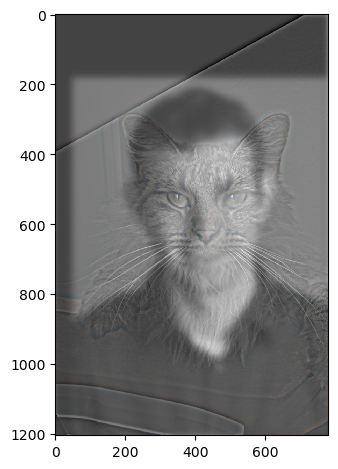

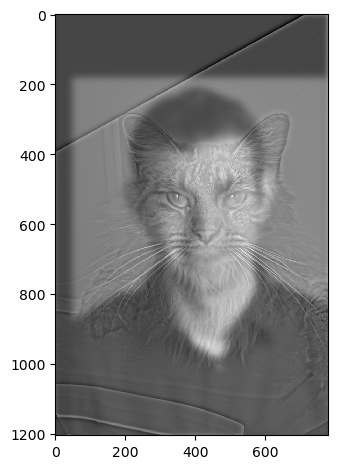

In [142]:
# color
show(hybrid_image(lowpass_derek, highpass_nutmeg, color1=False, color2=True))

# grayscale
show(hybrid_image(lowpass_derek, highpass_nutmeg, color1=False, color2=False))

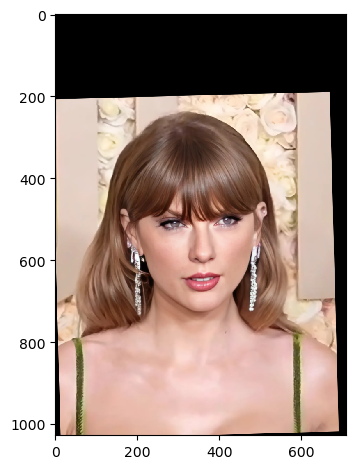

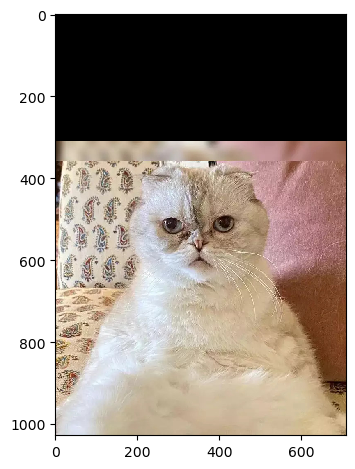

In [175]:
with open("taylor_aligned", 'rb') as f:
    taylor_aligned = pickle.load(f)
    
with open("taylor_cat_aligned", 'rb') as f:
    taylor_cat_aligned = pickle.load(f)

show(taylor_aligned)
show(taylor_cat_aligned)

In [179]:
lowpass_taylor, highpass_cat = low_pass_and_high_pass(taylor_aligned, taylor_cat_aligned, sigma1=7, sigma2=6)

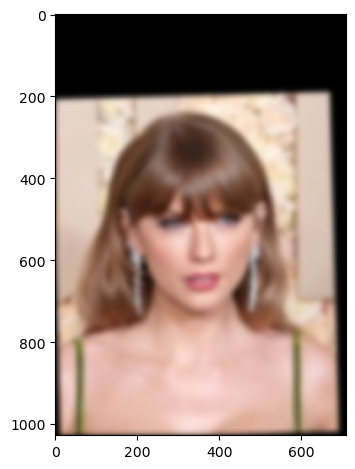

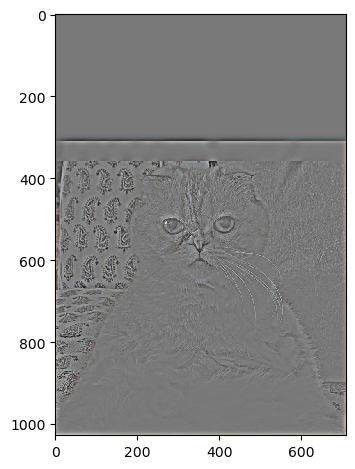

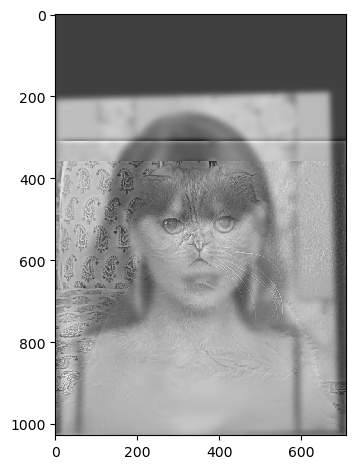

In [180]:
show(lowpass_taylor)
show(highpass_cat)
show(hybrid_image(lowpass_taylor, highpass_cat, color1=False, color2=False))

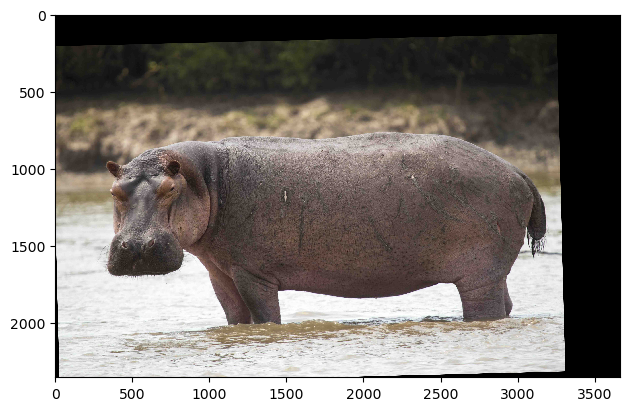

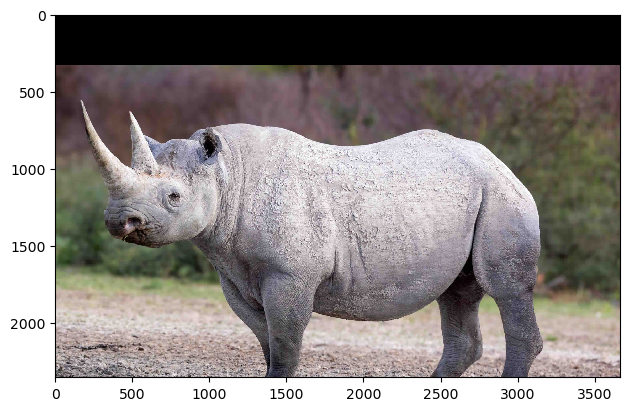

In [185]:
with open("hippo_aligned", 'rb') as f:
    hippo_aligned = pickle.load(f)
    
with open("rhino_aligned", 'rb') as f:
    rhino_aligned = pickle.load(f)

show(hippo_aligned)
show(rhino_aligned)

In [186]:
hippo_aligned = sk.transform.rescale(hippo_aligned, 0.125, anti_aliasing=True, channel_axis=2)
rhino_aligned = sk.transform.rescale(rhino_aligned, 0.125, anti_aliasing=True, channel_axis=2)


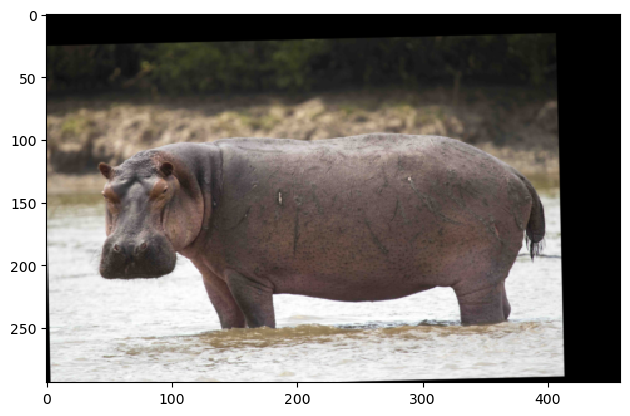

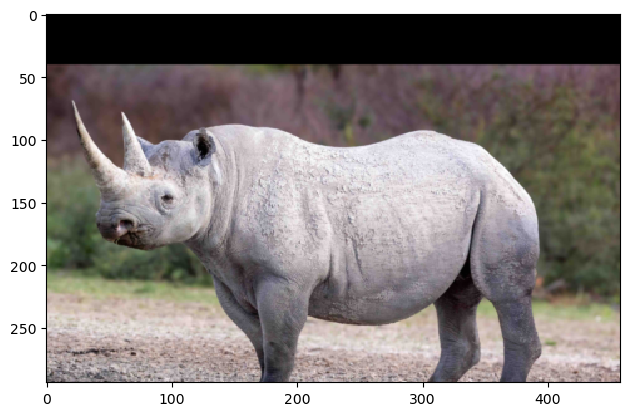

In [187]:
show(hippo_aligned)
show(rhino_aligned)

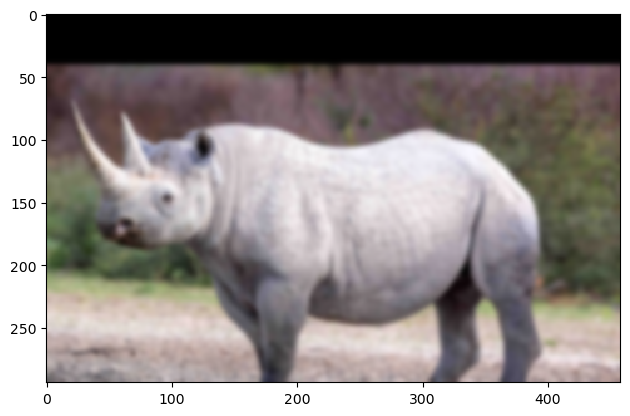

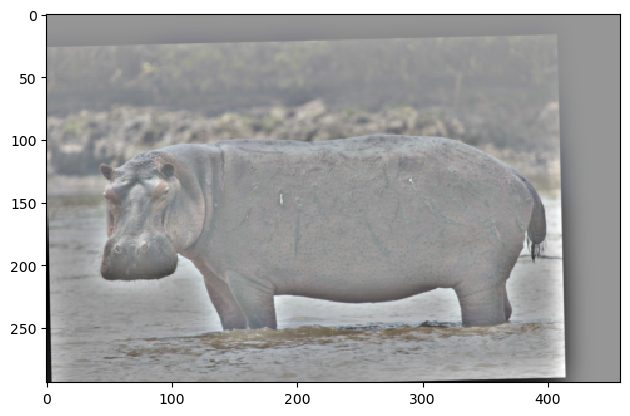

In [297]:
lowpass_rhino, highpass_hippo = low_pass_and_high_pass(rhino_aligned, hippo_aligned, sigma1=2, sigma2=10)
show(lowpass_rhino)
show(highpass_hippo)

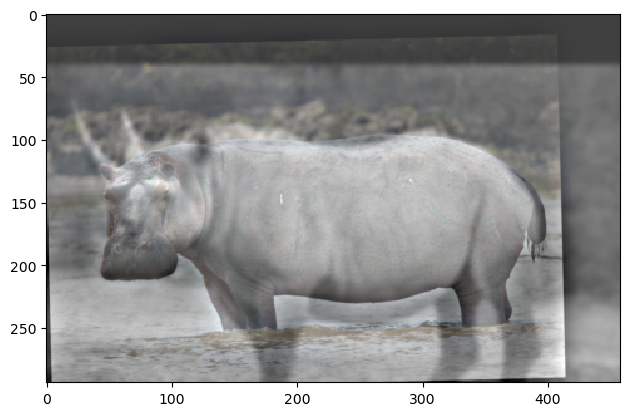

In [298]:
show(hybrid_image(lowpass_rhino, highpass_hippo, color1=False, color2=True))

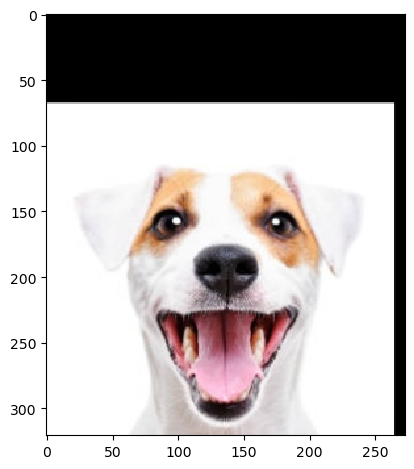

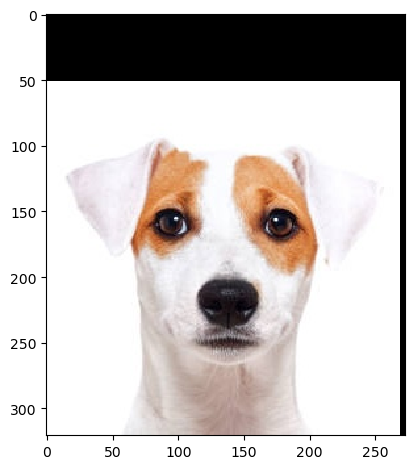

In [102]:
with open("happy_dog_aligned", 'rb') as f:
    happy_dog_aligned = pickle.load(f)
    
with open("sad_dog_aligned", 'rb') as f:
    sad_dog_aligned = pickle.load(f)

show(happy_dog_aligned, out_file="happy_dog_aligned.jpg")
show(sad_dog_aligned, out_file="sad_dog_aligned.jpg")

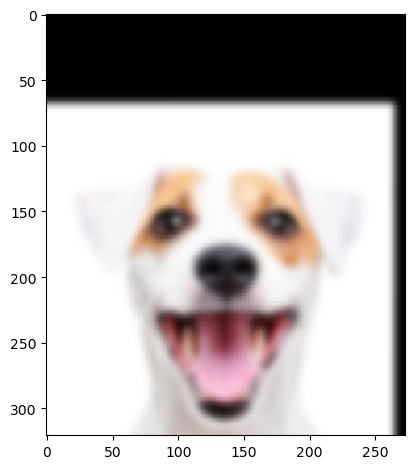

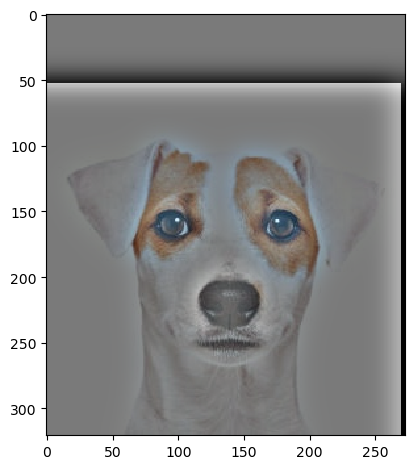

In [103]:
lowpass_happy, highpass_sad = low_pass_and_high_pass(happy_dog_aligned, sad_dog_aligned, sigma1=3, sigma2=10)
show(lowpass_happy, out_file="happy_dog_lowpass.jpg")
show(highpass_sad, out_file="sad_dog_highpass.jpg")

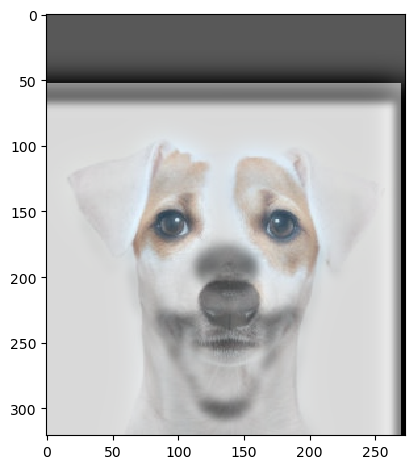

In [104]:
show(hybrid_image(lowpass_happy, highpass_sad, color1=False, color2=True), out_file="hybrid_dog.jpg")

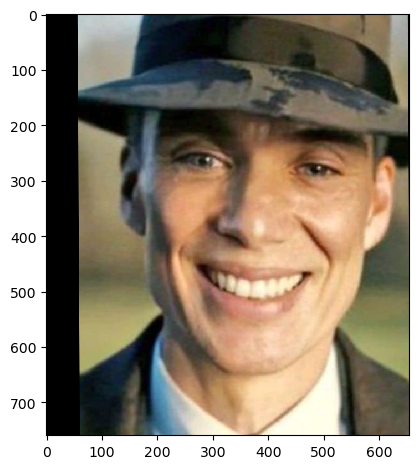

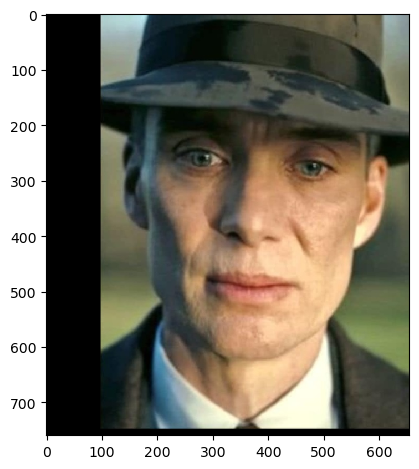

In [36]:
with open("happy_cillian_aligned", 'rb') as f:
    happy_cillian_aligned = pickle.load(f)
    
with open("sad_cillian_aligned", 'rb') as f:
    sad_cillian_aligned = pickle.load(f)

show(happy_cillian_aligned, out_file="happy_cillian_aligned.jpg")
show(sad_cillian_aligned, out_file="sad_cillian_aligned.jpg")

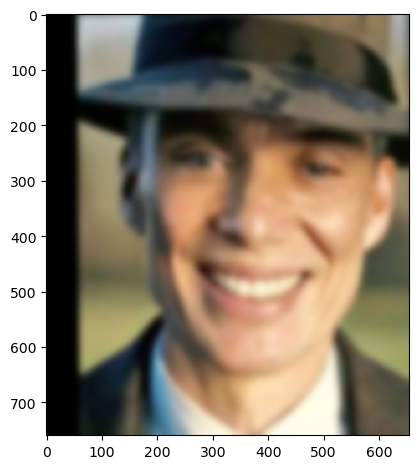

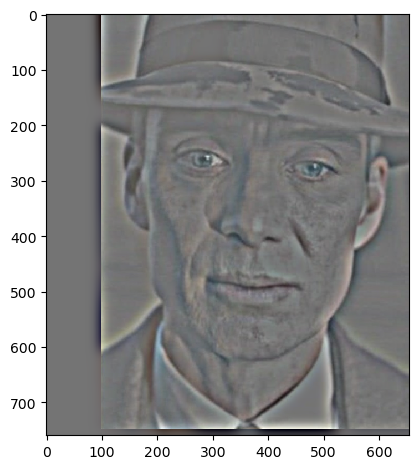

In [40]:
lowpass_happy, highpass_sad = low_pass_and_high_pass(happy_cillian_aligned, sad_cillian_aligned, sigma1=6, sigma2=10)
show(lowpass_happy, out_file="happy_cillian_lowpass.jpg")
show(highpass_sad, out_file="sad_cillian_highpass.jpg")

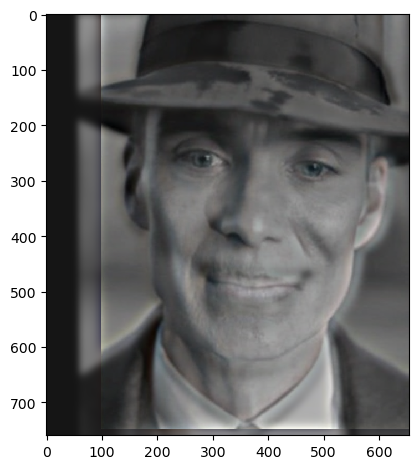

In [41]:
cillian_hybrid = hybrid_image(lowpass_happy, highpass_sad, color1=False, color2=True)
show(cillian_hybrid, out_file="hybrid_cillian.jpg")

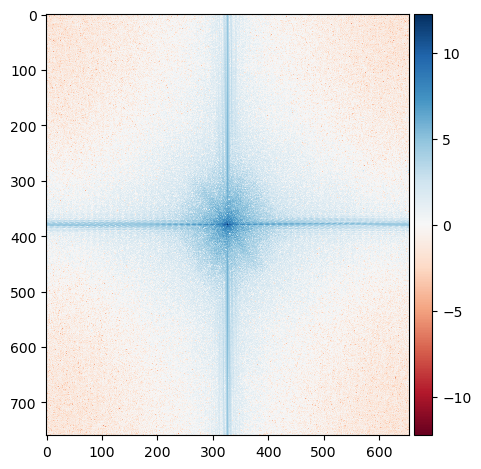

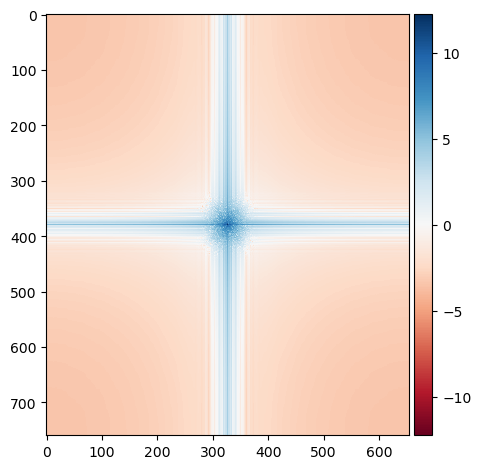

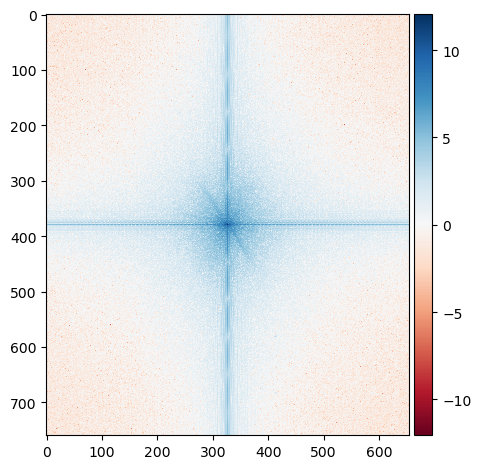

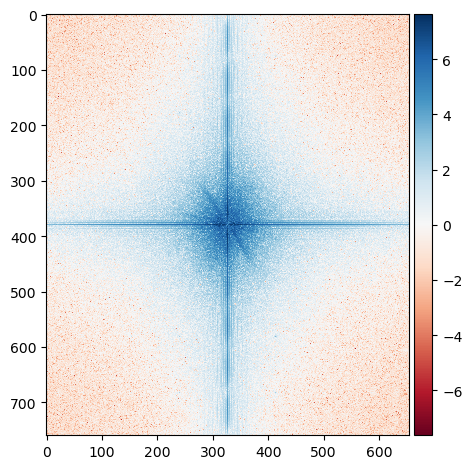

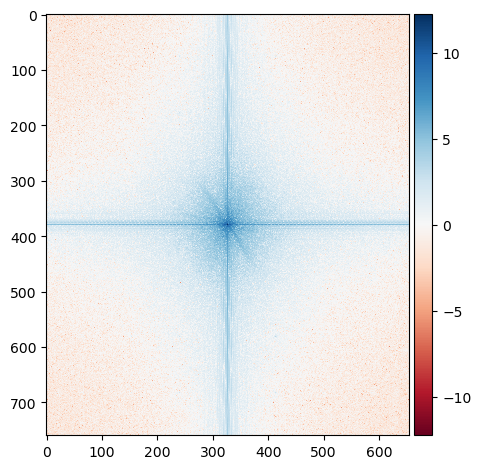

In [51]:
show_fourier(happy_cillian_aligned)#, out_file="fft_happy_cillian_aligned")
show_fourier(lowpass_happy)#, out_file="fft_happy_cillian_lowpass.jpg")
show_fourier(sad_cillian_aligned)#, out_file="fft_sad_cillian_aligned.jpg")
show_fourier(highpass_sad)#, out_file="fft_sad_cillian_highpass.jpg")
show_fourier(cillian_hybrid)#, out_file="fft_hybrid_cillian.jpg")

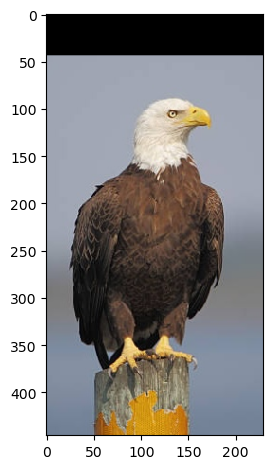

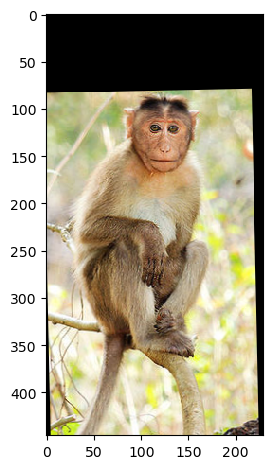

In [52]:
with open("eagle_aligned", 'rb') as f:
    eagle_aligned = pickle.load(f)
    
with open("monkey_aligned", 'rb') as f:
    monkey_aligned = pickle.load(f)

show(eagle_aligned, out_file="eagle_aligned.jpg")
show(monkey_aligned, out_file="monkey_aligned.jpg")

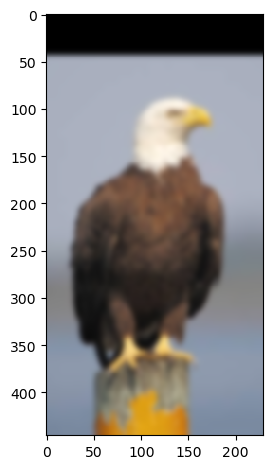

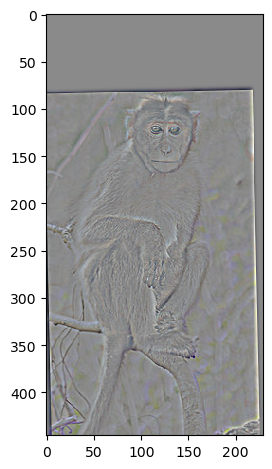

In [53]:
lowpass_eagle, highpass_monkey = low_pass_and_high_pass(eagle_aligned, monkey_aligned, sigma1=3, sigma2=2)
show(lowpass_eagle, out_file="eagle_lowpass.jpg")
show(highpass_monkey, out_file="monkey_highpass.jpg")

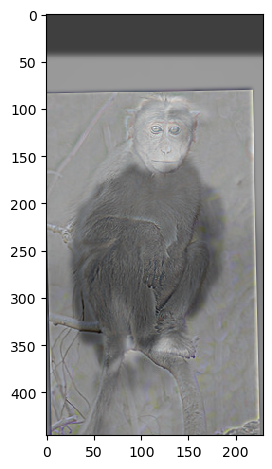

In [54]:
meagle = hybrid_image(lowpass_eagle, highpass_monkey, color1=False, color2=True)
show(meagle, out_file="monkey_eagle_hybrid.jpg")

## Parts 2.3 and 2.4: Multi-resolution Blending and the Oraple journey

In [105]:
def apply_gaussian(img: np.ndarray, sigma: int | float, ksize: int | None = None):
    """Applies a Gaussian filter with the specified sigma and kernel size to an img.
    Works for both single-channel and multi-channel images"""
    gaussian = get_gaussian(sigma=sigma, ksize=ksize)

    if len(img.shape) == 3:
        return convolve_3d(img, gaussian)
    else:
        return convolve2d(img, gaussian, mode="same")


def get_gaussian_stack(img, depth, sigma, ksize=None):
    """Creates a Gaussian stack for an image by repeatedly applying a Gaussian filter"""
    stack = [img]
    for _ in range(depth - 1):
        applied_gaussian = apply_gaussian(stack[-1], sigma, ksize)
        stack.append(applied_gaussian)
    return stack


def get_laplacian_stack(gaussian_stack):
    """Creates a Laplacian stack for an image by subtracting consecutive entries of the provided Gaussian stack"""
    laplacian_stack = []
    for i in range(len(gaussian_stack) - 1):
        laplacian_stack.append(gaussian_stack[i] - gaussian_stack[i + 1])
    laplacian_stack.append(gaussian_stack[-1])
    return laplacian_stack

def combined_laplacian(left_laplacian, right_laplacian, mask_gaussian):
    """Combines the Laplacian stacks of two images using the Gaussian stack for a mask
    in order to complete multi-resolution blending"""

    def multiply(rgb, m):
        """Elementwise multiplication of a multi-channel image with a 2D mask.
        Multiply each channel independently"""
        assert rgb.ndim == 3
        assert m.ndim == 2
        result = np.dstack([np.multiply(rgb[:, :, i], m)for i in range(rgb.shape[2])])
        assert result.ndim == 3
        return result


    assert len(left_laplacian) == len(right_laplacian) == len(mask_gaussian)

    combined_laplacian = []
    left_masks = []
    right_masks = []

    # iterate over all the entries of the stacks
    for i, mask in enumerate(mask_gaussian):

        # mask the left laplacian with the mask
        left_masked = multiply(left_laplacian[i], mask)

        # mask the right laplacian with the inverse of the mask
        right_masked = multiply(right_laplacian[i], (1 - mask))
        left_masks.append(left_masked)
        right_masks.append(right_masked)

        # combine the left and right masked laplacians
        combined_laplacian.append(left_masked + right_masked)
    return left_masks, right_masks, combined_laplacian

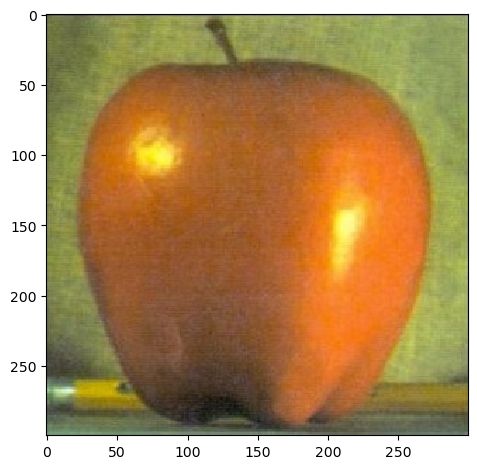

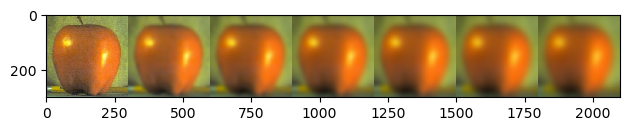

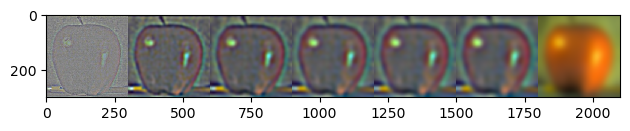

In [106]:
apple = read_image("./apple.jpeg")
show(apple)
apple_gaussian_stack = get_gaussian_stack(apple, depth=7, sigma=5)
show(apple_gaussian_stack, out_file="apple_gaussian_stack.jpg")
apple_laplacian_stack = get_laplacian_stack(apple_gaussian_stack)
show(apple_laplacian_stack, out_file="apple_laplacian_stack.jpg")

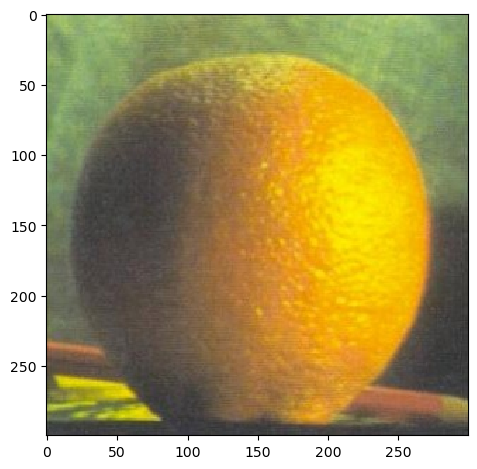

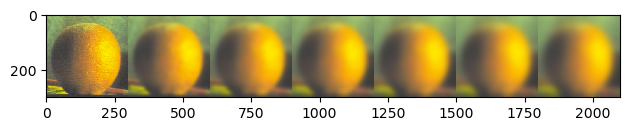

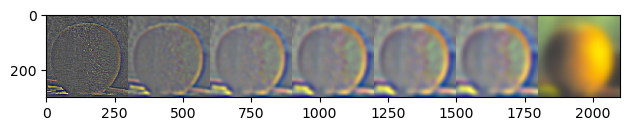

In [116]:
orange = read_image("./orange.jpeg")
show(orange)
orange_gaussian_stack = get_gaussian_stack(orange, depth=7, sigma=5)
show(orange_gaussian_stack, out_file="orange_gaussian_stack.jpg")
orange_laplacian_stack = get_laplacian_stack(orange_gaussian_stack)
show(orange_laplacian_stack, out_file="orange_laplacian_stack.jpg")

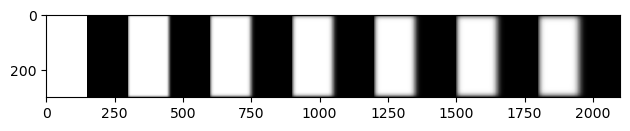

In [117]:
# blending
mask = np.hstack([np.ones((apple.shape[0], apple.shape[1] // 2)),np.zeros((apple.shape[0], apple.shape[1] - apple.shape[1] // 2)) ])
mask_gaussian_stack = get_gaussian_stack(mask, depth=7, sigma=5)
show(mask_gaussian_stack, out_file="oraple_mask_gaussian_stack.jpg")

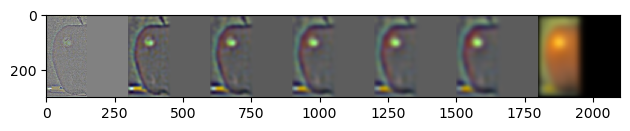

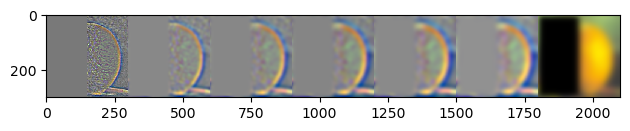

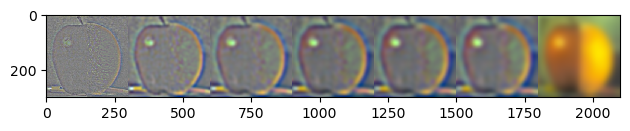

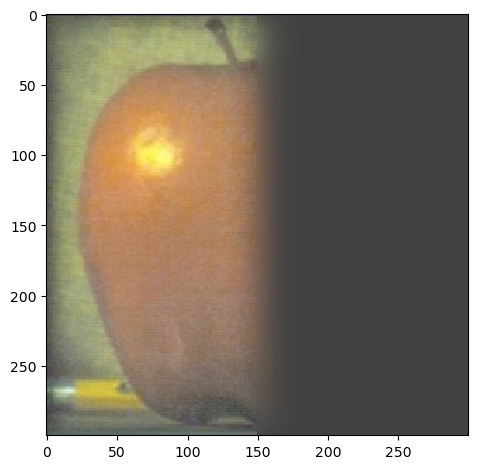

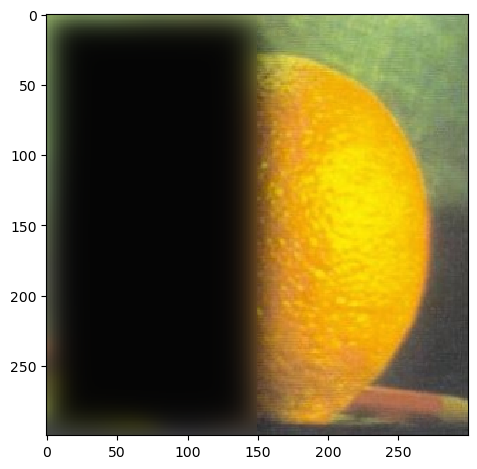

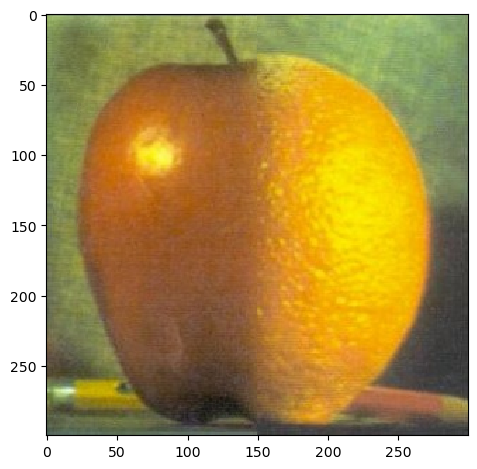

In [119]:


left_masks, right_masks, oraple = combined_laplacian(apple_laplacian_stack, orange_laplacian_stack, mask_gaussian_stack)
show(left_masks, out_file="apple_left_masks.jpg")
show(right_masks, out_file="orange_right_masks.jpg")
show(oraple, out_file="oraple_levels.jpg")

show(sum(left_masks), out_file="apple_left.jpg")
show(sum(right_masks), out_file="orange_right.jpg")
show(sum(oraple), out_file="oraple.jpg")
        

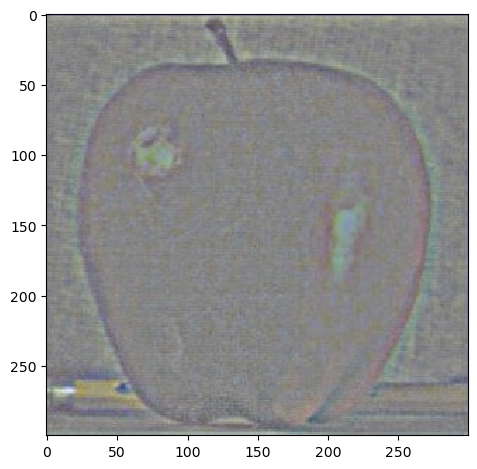

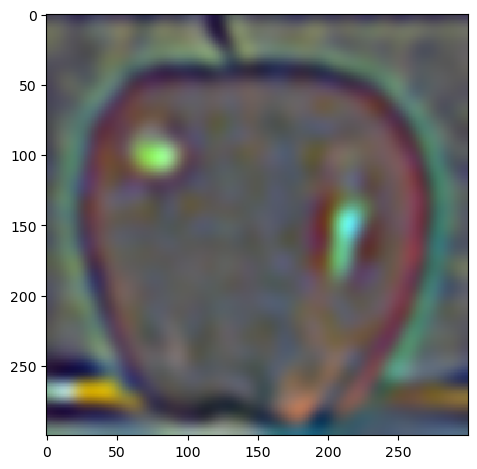

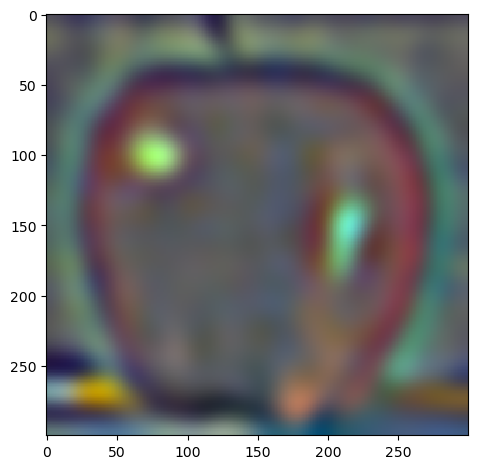

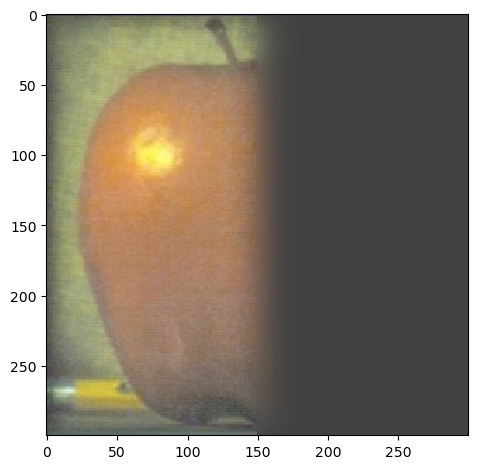

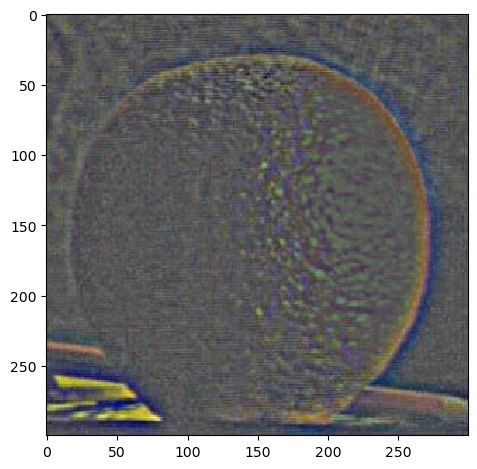

...

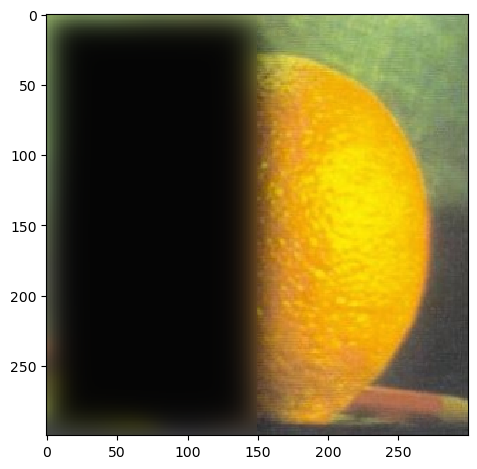

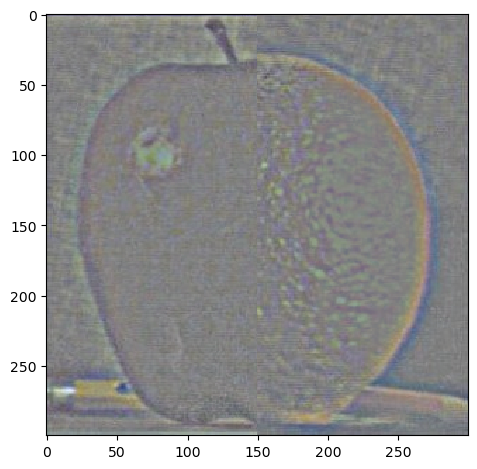

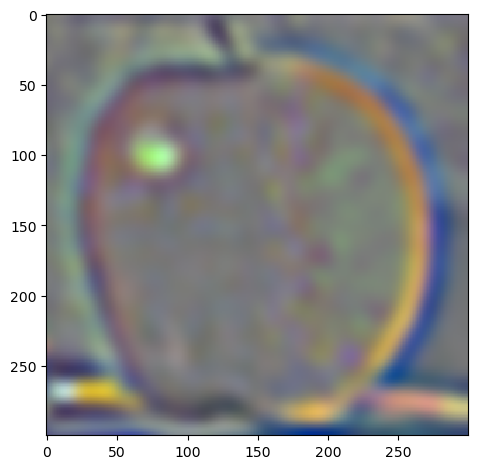

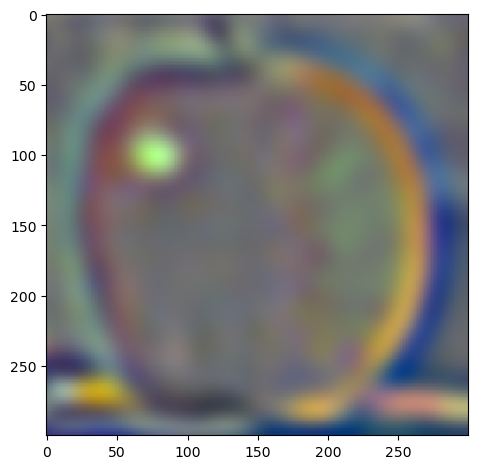

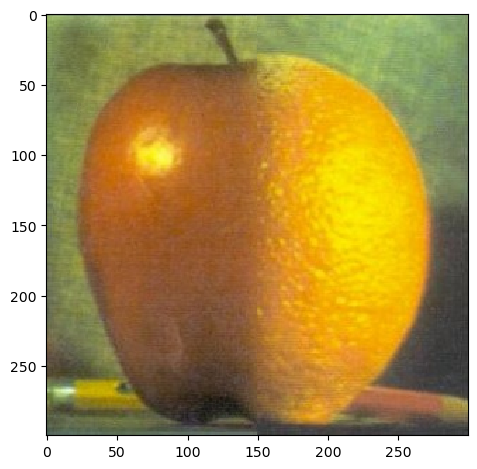

In [118]:
show(apple_laplacian_stack[0], out_file="apple_0.jpg")
show(apple_laplacian_stack[2], out_file="apple_2.jpg")
show(apple_laplacian_stack[4], out_file="apple_4.jpg")
show(sum(left_masks), out_file="apple_left.jpg")

show(orange_laplacian_stack[0], out_file="orange_0.jpg")
show(orange_laplacian_stack[2], out_file="orange_2.jpg")
show(orange_laplacian_stack[4], out_file="orange_4.jpg")
show(sum(right_masks), out_file="orange_right.jpg")

show(oraple[0], out_file="oraple_0.jpg")
show(oraple[2], out_file="oraple_2.jpg")
show(oraple[4], out_file="oraple_4.jpg")
show(sum(oraple), out_file="oraple.jpg")


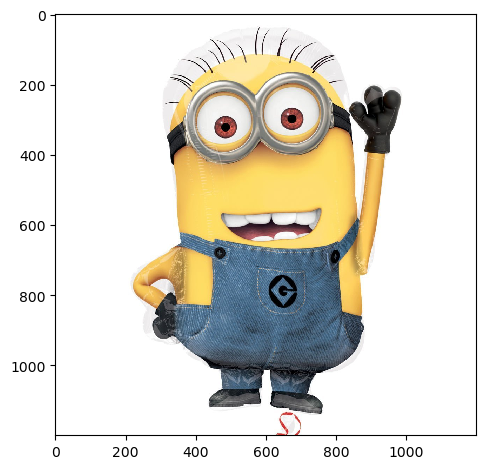

In [148]:
minions = read_image("minions.jpeg")
show(minions)

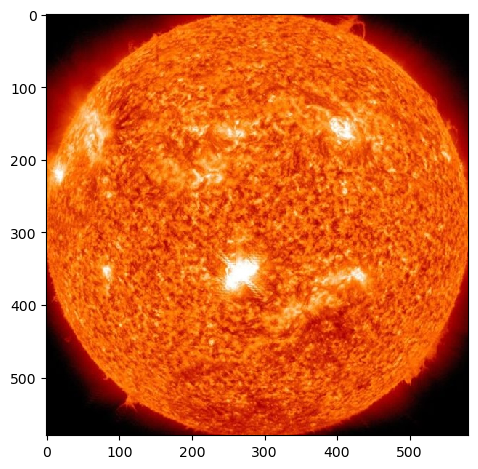

In [149]:
sun = read_image("sun.jpeg")
show(sun)

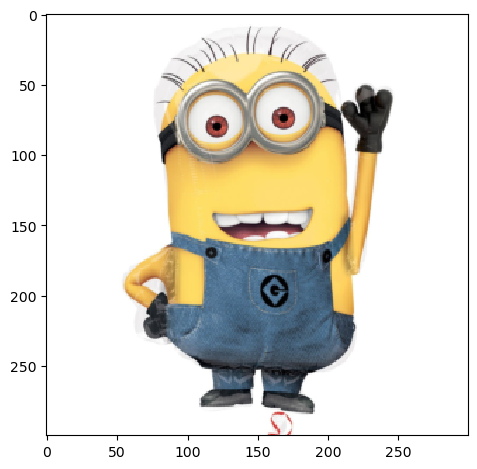

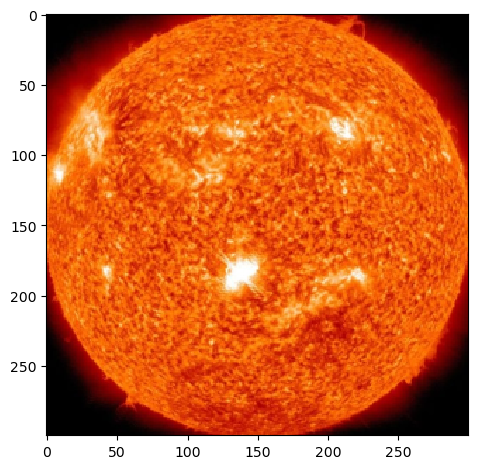

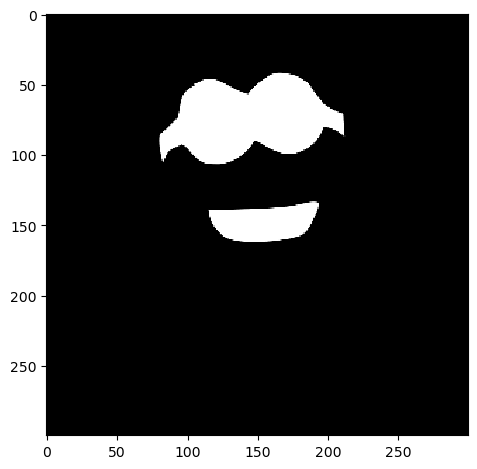

In [150]:
shape = (300, 300, 3)
minions = sk.transform.resize(minions, shape, anti_aliasing=True)
show(minions, out_file="minions.jpg")
sun = sk.transform.resize(sun, shape, anti_aliasing=True)
show(sun, out_file="sun.jpg")
minions_mask = read_image("minions_mask.png")
minions_mask = sk.transform.resize(minions_mask, shape, anti_aliasing=False)
minions_mask = minions_mask[:, :, 0] # just take a single channel
show(minions_mask, out_file="minions_mask.jpg")

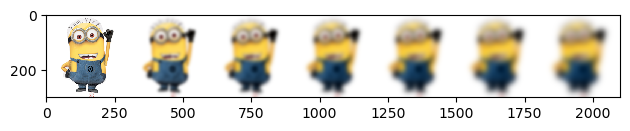

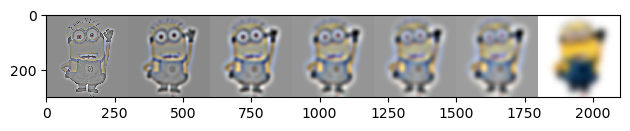

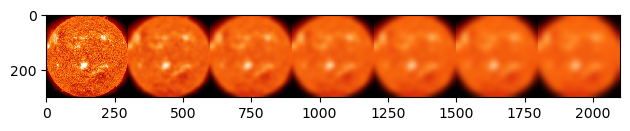

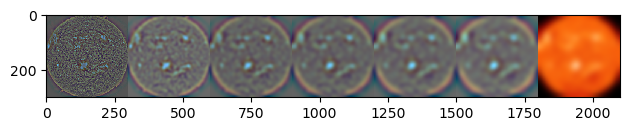

In [151]:
minions_gaussian_stack = get_gaussian_stack(minions, depth=7, sigma=5)
show(minions_gaussian_stack, out_file="minions_gaussian.jpg")
minions_laplacian_stack = get_laplacian_stack(minions_gaussian_stack)
show(minions_laplacian_stack, out_file="minions_laplacian.jpg")
sun_gaussian_stack = get_gaussian_stack(sun, depth=7, sigma=5)
show(sun_gaussian_stack, out_file="sun_gaussian.jpg")
sun_laplacian_stack = get_laplacian_stack(sun_gaussian_stack)
show(sun_laplacian_stack, out_file="sun_laplacian.jpg")

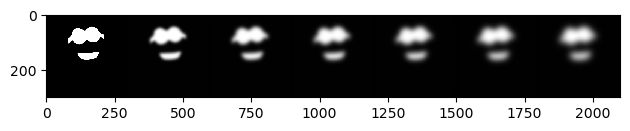

In [152]:
mask_gaussian_stack = get_gaussian_stack(minions_mask, depth=7, sigma=5)
show(mask_gaussian_stack, out_file="minions_mask_gaussian.jpg")

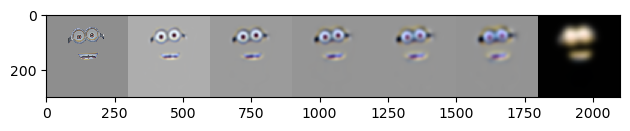

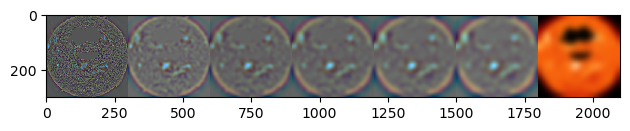

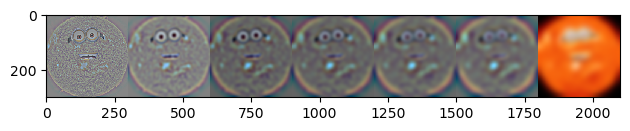

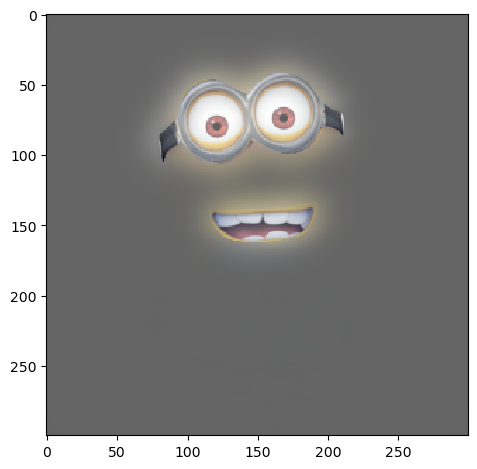

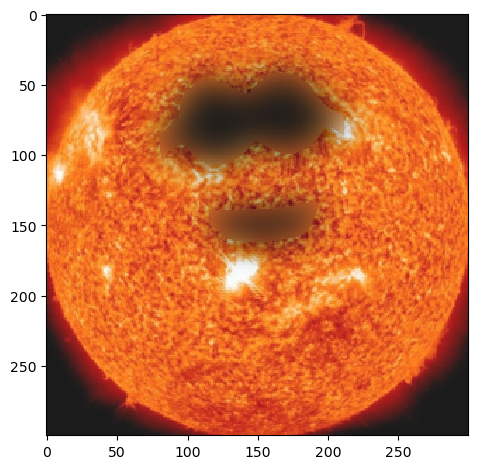

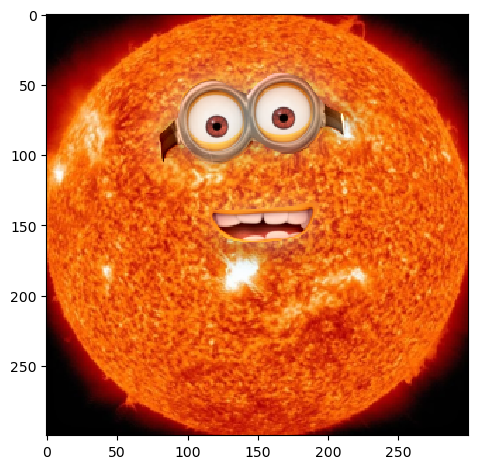

In [153]:
def combined_laplacian(left_laplacian, right_laplacian, mask_gaussian, location=None):
    def multiply(rgb, m):
        assert len(rgb.shape) == 3
        assert len(m.shape) == 2
        result = np.dstack([np.multiply(rgb[:, :, i], m)for i in range(rgb.shape[2])])
        assert len(result.shape) == 3
        return result


    assert len(left_laplacian) == len(right_laplacian) == len(mask_gaussian)

    combined_laplacian = []
    left_masks = []
    right_masks = []
    for i, mask in enumerate(mask_gaussian):
        left_masked = multiply(left_laplacian[i], mask)
        right_masked = multiply(right_laplacian[i], (1 - mask))
        left_masks.append(left_masked)
        right_masks.append(right_masked)
        combined_laplacian.append(left_masked + right_masked)
    return left_masks, right_masks, combined_laplacian

left_masks, right_masks, sunion = combined_laplacian(minions_laplacian_stack, sun_laplacian_stack, mask_gaussian_stack)
show(left_masks, out_file="minions_laplacian_left.jpg")
show(right_masks, out_file="sun_laplacian_right.jpg")
show(sunion, out_file="sunion_laplacian.jpg")

show(sum(left_masks), out_file="minions_left.jpg")
show(sum(right_masks), out_file="sun_right.jpg")
show(sum(sunion), should_rescale=False, should_clip=True, out_file="sunion.jpg")
        

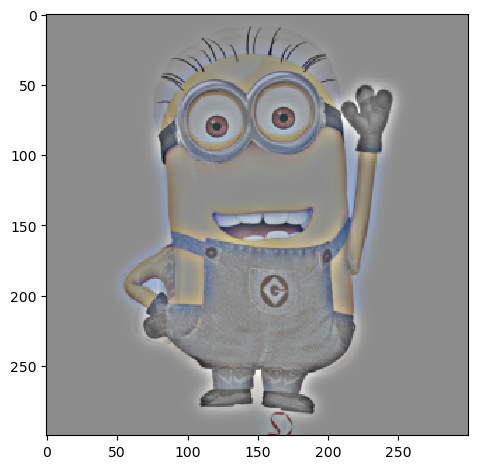

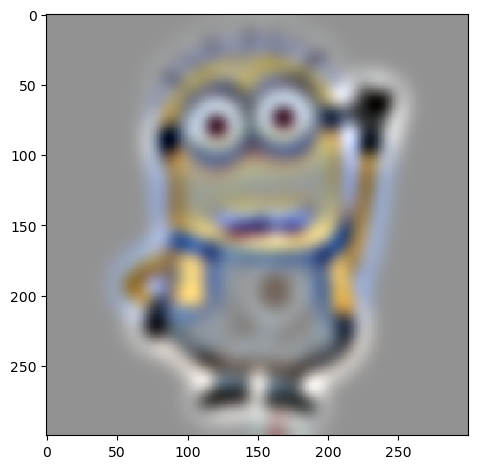

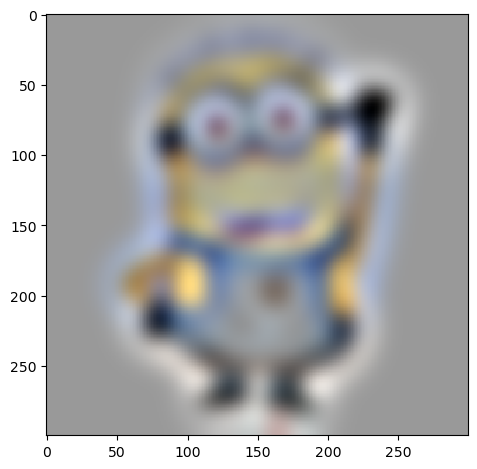

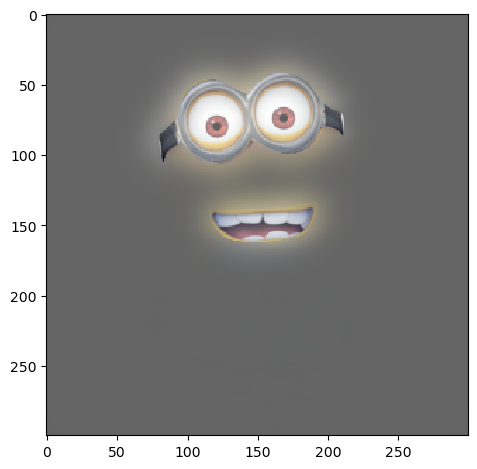

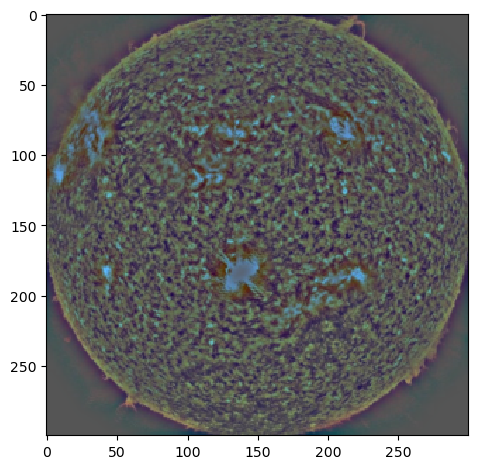

...

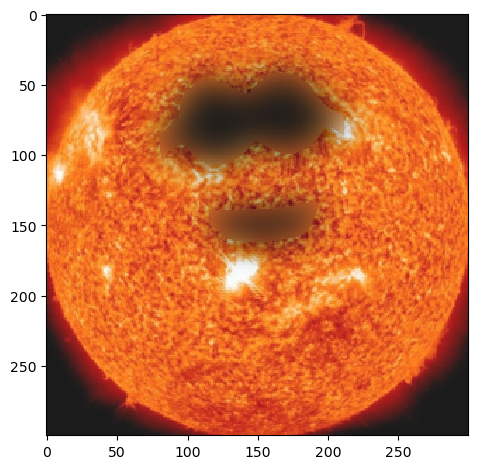

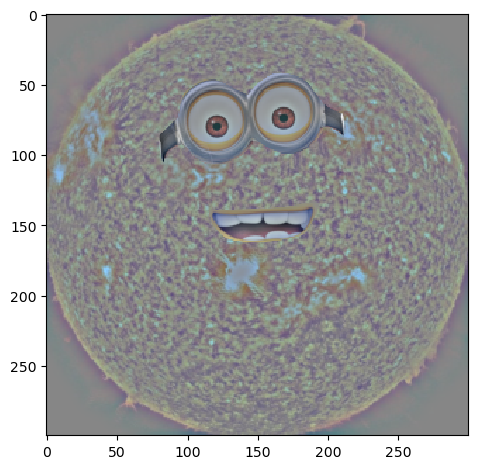

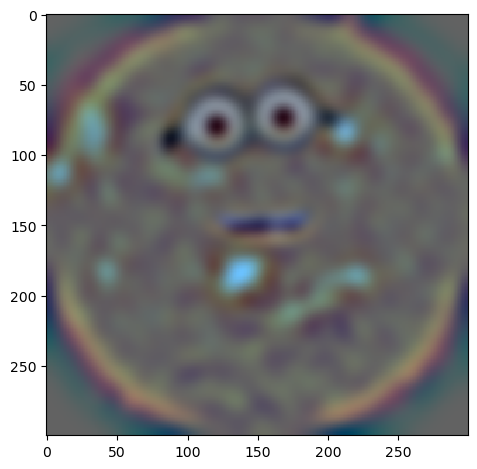

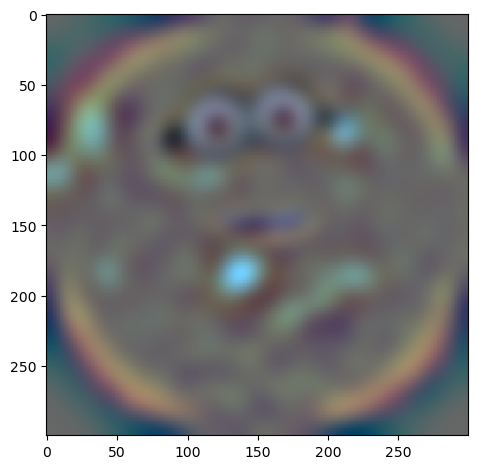

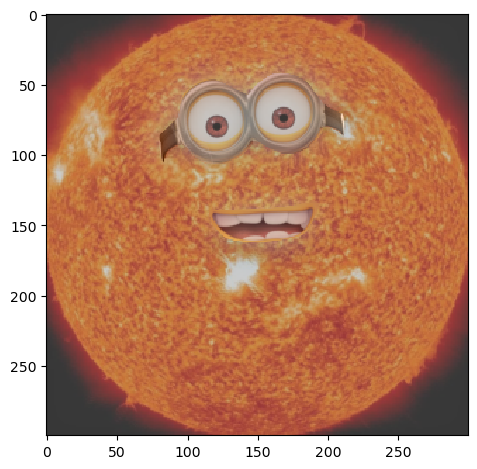

In [154]:
show(minions_laplacian_stack[0], out_file="minions_0.jpg")
show(minions_laplacian_stack[2], out_file="minions_2.jpg")
show(minions_laplacian_stack[4], out_file="minions_4.jpg")
show(sum(left_masks), out_file="minions_left.jpg")

show(sun_laplacian_stack[0], out_file="sun_0.jpg")
show(sun_laplacian_stack[2], out_file="sun_2.jpg")
show(sun_laplacian_stack[4], out_file="sun_4.jpg")
show(sum(right_masks), out_file="sun_right.jpg")

show(sunion[0], out_file="sunion_0.jpg")
show(sunion[2], out_file="sunion_2.jpg")
show(sunion[4], out_file="sunion_4.jpg")
show(sum(sunion), out_file="sunion.jpg")


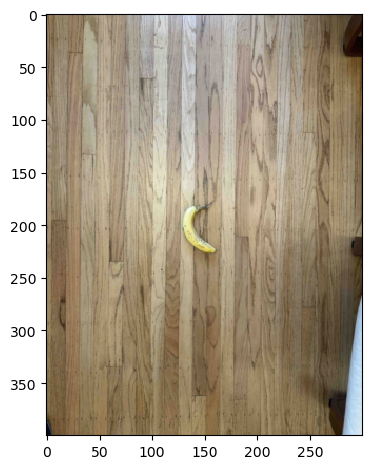

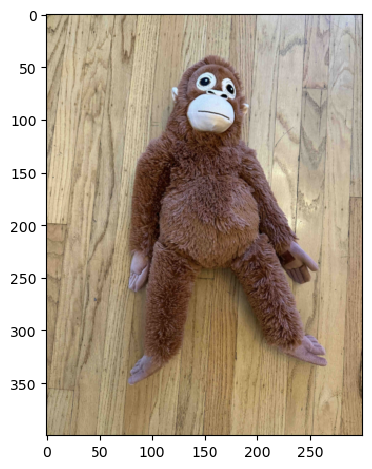

/Users/Kanav/opt/anaconda3/envs/cs180/lib/python3.12/site-packages/skimage/io/_plugins/matplotlib_plugin.py:158: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


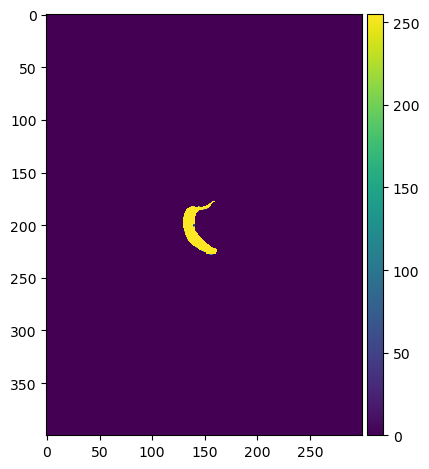

/var/folders/g2/py91tm2d5bj465mlzrg0r1l40000gn/T/ipykernel_13832/4117893726.py:40: UserWarning: ./out/banana_mask.jpg is a low contrast image
  skio.imsave(fname, result)


In [155]:
shape = (400, 300, 3)

banana = read_image("banana.jpeg")
banana = sk.transform.resize(banana, shape, anti_aliasing=True)
show(banana, out_file="banana.jpg")

monkey = read_image("monkey stuff.jpg")
monkey = sk.transform.resize(monkey, shape, anti_aliasing=True)
show(monkey, out_file="orangutan.jpg")

banana_mask = read_image("banana mask.png")
banana_mask = sk.transform.resize(banana_mask, shape, anti_aliasing=False)
banana_mask = banana_mask[:, :, 0] # just take a single channel
show(banana_mask, out_file="banana_mask.jpg")

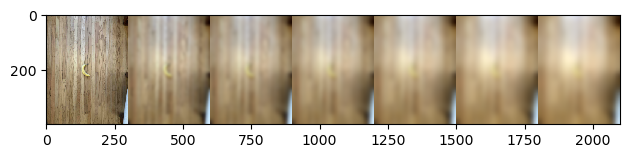

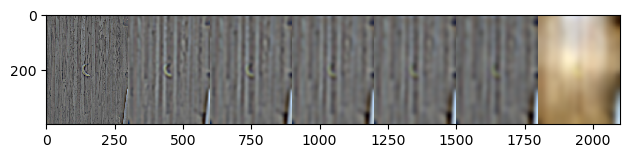

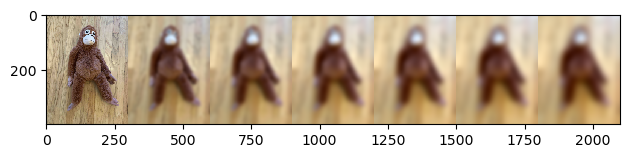

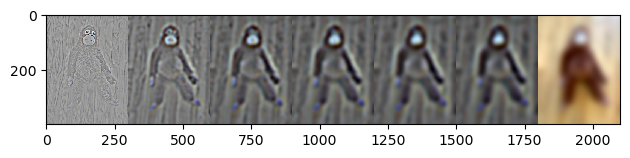

In [156]:
banana_gaussian_stack = get_gaussian_stack(banana, depth=7, sigma=5)
show(banana_gaussian_stack, out_file="banana_gaussian.jpg")
banana_laplacian_stack = get_laplacian_stack(banana_gaussian_stack)
show(banana_laplacian_stack, out_file="banana_laplacian.jpg")

monkey_gaussian_stack = get_gaussian_stack(monkey, depth=7, sigma=5)
show(monkey_gaussian_stack, out_file="orangutan_gaussian.jpg")
monkey_laplacian_stack = get_laplacian_stack(monkey_gaussian_stack)
show(monkey_laplacian_stack, out_file="orangutan_laplacian.jpg")

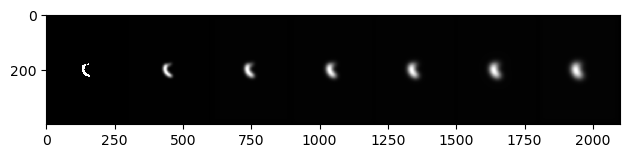

In [157]:
mask_gaussian_stack = get_gaussian_stack(banana_mask, depth=7, sigma=5)
show(mask_gaussian_stack, out_file="banana_mask_gaussian.jpg")

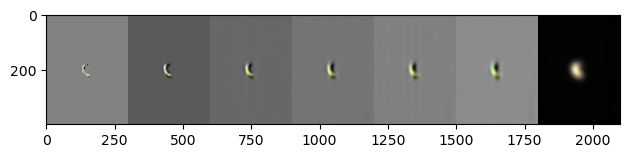

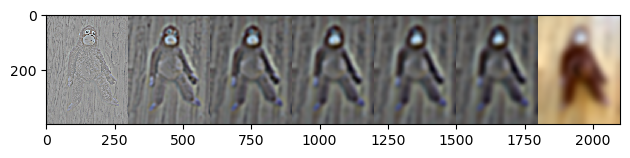

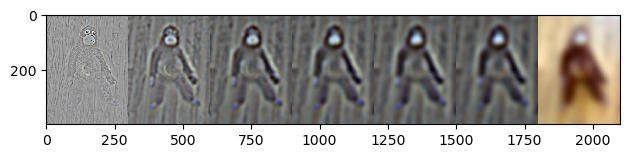

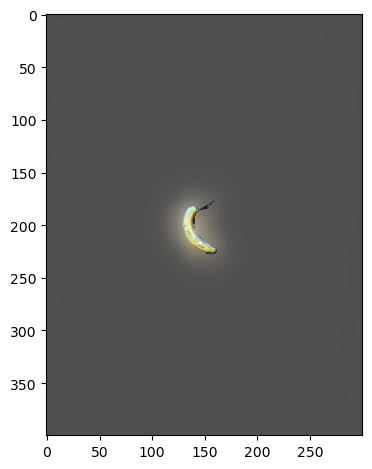

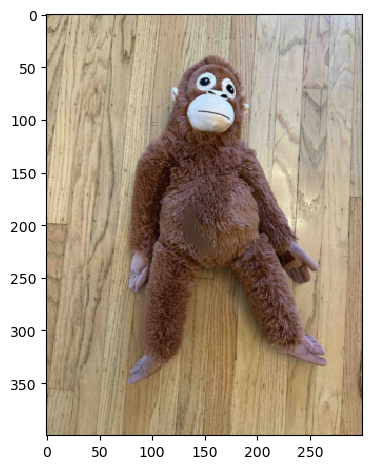

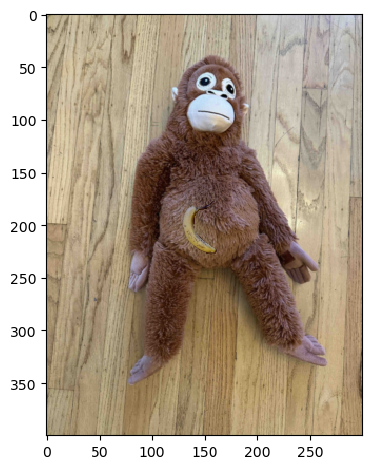

In [158]:
left_masks, right_masks, monana = combined_laplacian(banana_laplacian_stack, monkey_laplacian_stack, mask_gaussian_stack)
show(left_masks, out_file="banana_left_laplacian.jpg")
show(right_masks, out_file="orangutan_right_laplacian.jpg")
show(monana, out_file="monana_laplacian.jpg")

show(sum(left_masks), out_file="banana_left.jpg")
show(sum(right_masks), out_file="orangutan_right.jpg")
show(sum(monana), should_rescale=False, should_clip=True, out_file="monana.jpg")
        

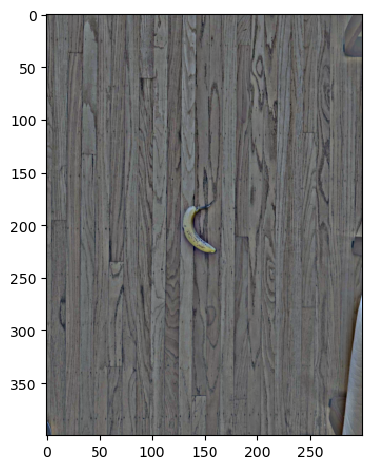

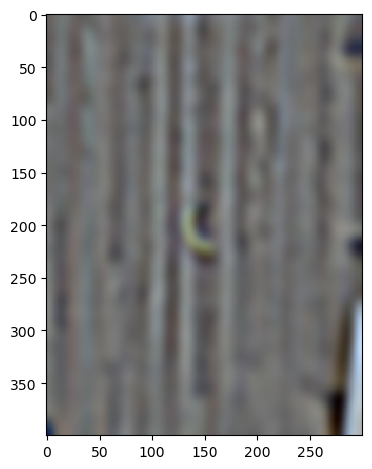

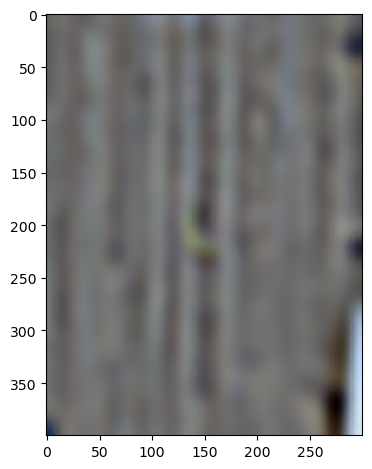

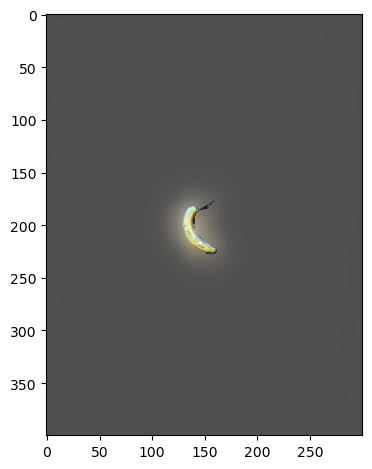

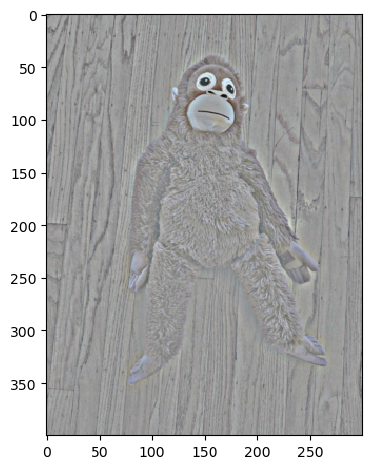

...

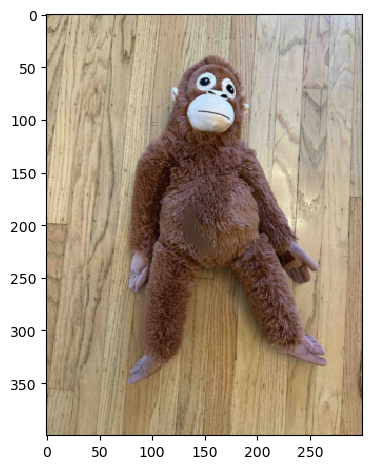

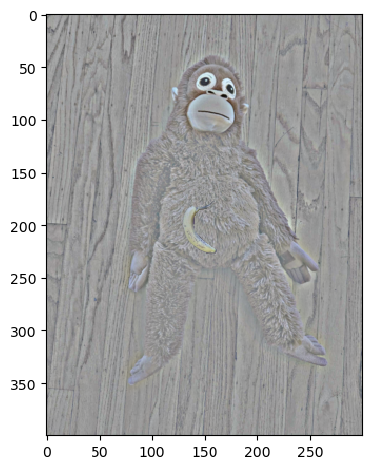

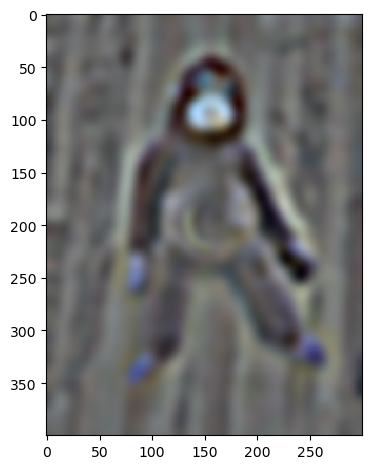

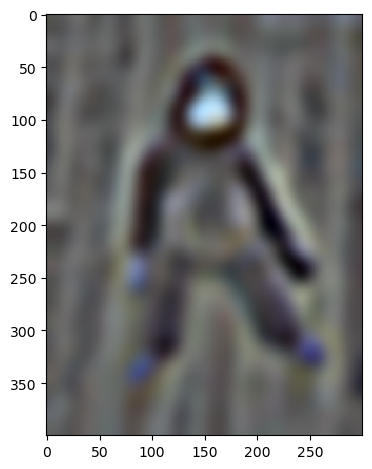

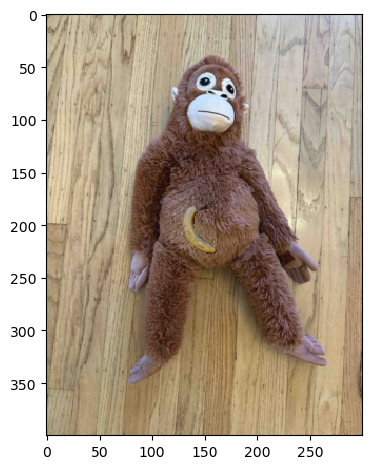

In [159]:
show(banana_laplacian_stack[0], out_file="banana_0.jpg")
show(banana_laplacian_stack[2], out_file="banana_2.jpg")
show(banana_laplacian_stack[4], out_file="banana_4.jpg")
show(sum(left_masks), out_file="banana_left.jpg")

show(monkey_laplacian_stack[0], out_file="orangutan_0.jpg")
show(monkey_laplacian_stack[2], out_file="orangutan_2.jpg")
show(monkey_laplacian_stack[4], out_file="orangutan_4.jpg")
show(sum(right_masks), out_file="orangutan_right.jpg")

show(monana[0], out_file="monana_0.jpg")
show(monana[2], out_file="monana_2.jpg")
show(monana[4], out_file="monana_4.jpg")
show(sum(monana), out_file="monana.jpg")
